#Evaluating YOLO11 Model for Object Detection in Drone Footage

---

In this notebook, we will begin by testing pretrained YOLO11 model on our custom dataset. We further trained YOLO using a labeled dataset from Roboflow to enhance accuracy and performance. Finally, we’ll evaluate the model post-training to assess improvements. 😊

In [5]:
from google.colab import drive
drive.mount('/content/drive')

video_path = '/content/drive/MyDrive/ExtractedFrames/parking - 12 sept, 12pm.MP4'

Mounted at /content/drive


##Pretrained YOLOv11n

In [8]:
%pip install ultralytics supervision roboflow
import ultralytics
ultralytics.checks()

Ultralytics 8.3.24 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (8 CPUs, 51.0 GB RAM, 32.6/235.7 GB disk)


In [9]:
from ultralytics import YOLO
model = YOLO("/content/drive/MyDrive/yolo11n.pt")  # load a pretrained model

In [6]:
# Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [22]:
#No specific class is specified
results = model.predict(source="/content/drive/MyDrive/ExtractedFrames/ExtractedFrames/ExtractedFrames12PM/frame_10110.jpg", save=True)
results = model.predict(source="/content/drive/MyDrive/ExtractedFrames/ExtractedFrames/ExtractedFrames12PM/frame_14220.jpg", save=True)
results = model.predict(source="/content/drive/MyDrive/ExtractedFrames/ExtractedFrames/ExtractedFrames7AM/frame7am_21060.jpg", save=True)


image 1/1 /content/drive/MyDrive/ExtractedFrames/ExtractedFrames/ExtractedFrames12PM/frame_10110.jpg: 384x640 18 cell phones, 62.5ms
Speed: 5.0ms preprocess, 62.5ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)
Results saved to runs/detect/predict

image 1/1 /content/drive/MyDrive/ExtractedFrames/ExtractedFrames/ExtractedFrames12PM/frame_14220.jpg: 384x640 2 cars, 2 trucks, 8.7ms
Speed: 2.0ms preprocess, 8.7ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)
Results saved to runs/detect/predict

image 1/1 /content/drive/MyDrive/ExtractedFrames/ExtractedFrames/ExtractedFrames7AM/frame7am_21060.jpg: 384x640 3 cars, 1 truck, 1 traffic light, 9.6ms
Speed: 2.5ms preprocess, 9.6ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)
Results saved to runs/detect/predict


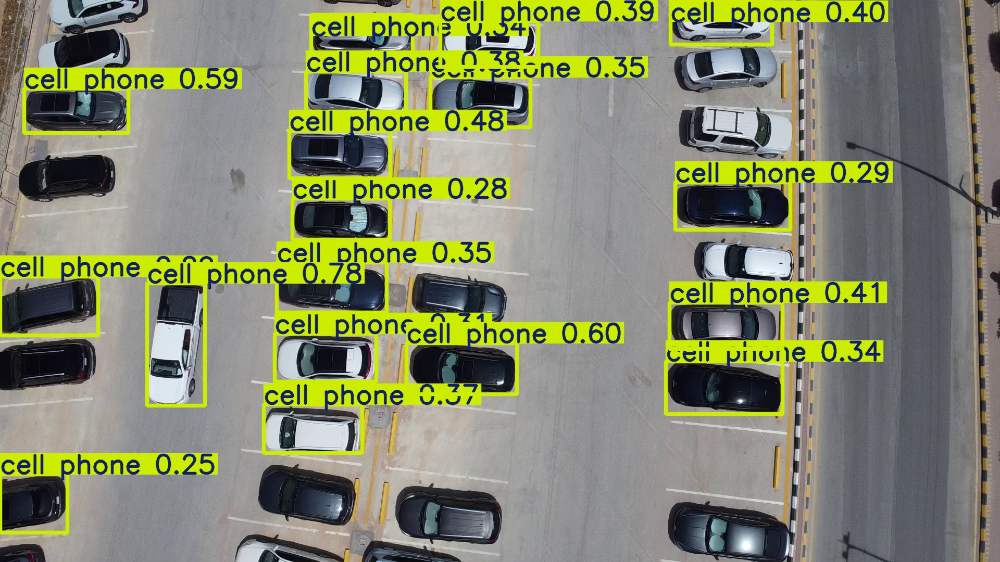

In [24]:
from IPython.display import Image as IPyImage
IPyImage(filename='/content/runs/detect/predict/frame_10110.jpg', width=600)

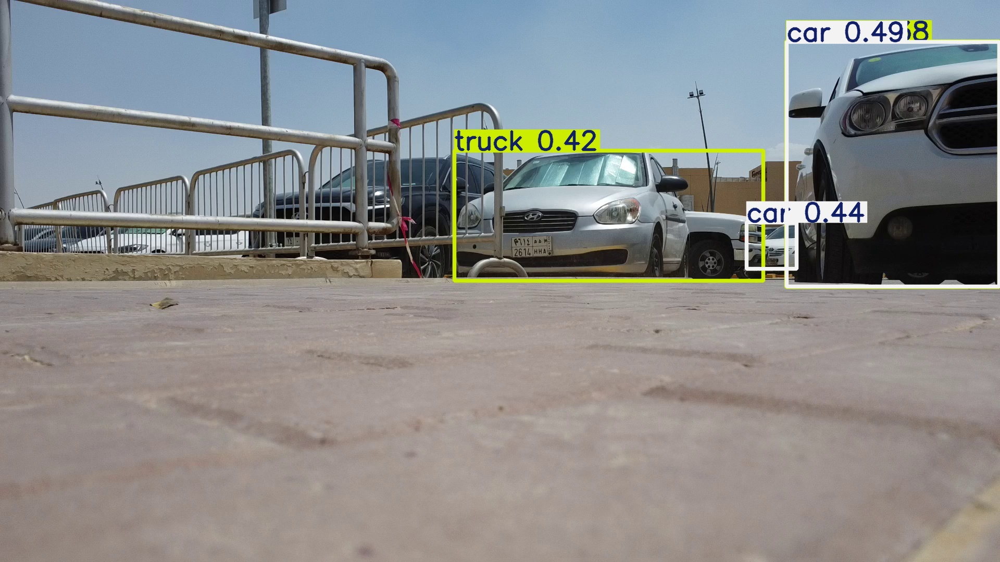

In [25]:
IPyImage(filename='/content/runs/detect/predict/frame_14220.jpg', width=600)

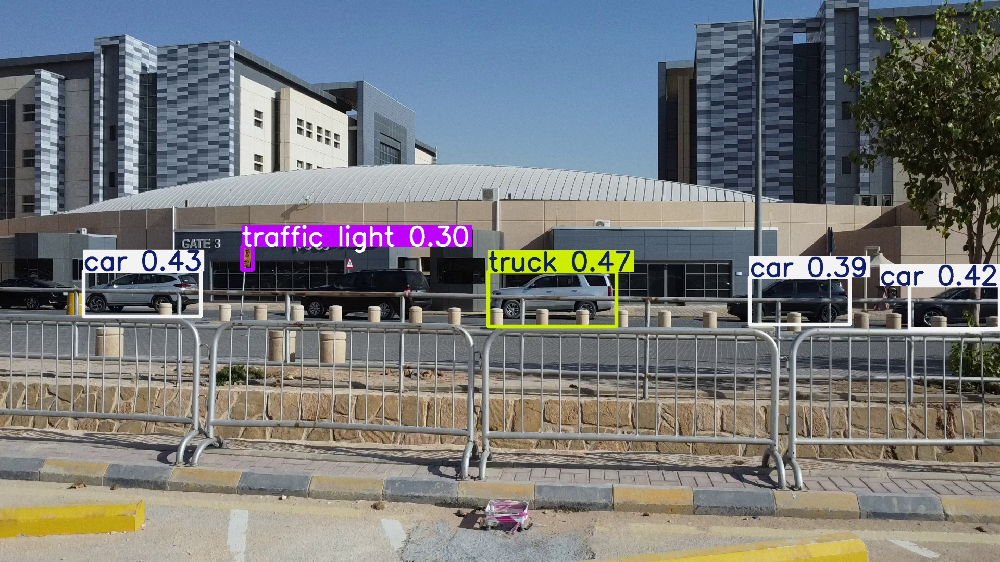

In [26]:
IPyImage(filename='/content/runs/detect/predict/frame7am_21060.jpg', width=600)

From the second and last frames displayed above, we observe that the pretrained YOLO11 model accurately detects cars when viewed from the front or side. However, it struggles with cars viewed from a top angle, which is the primary perspective in most frames of our dataset.

Interestingly, the model often misclassifies cars from a top view as the 'cellphone' class. This misclassification could actually help us later as we can leverage it to label our dataset more efficiently for further training or testing.

We imported YOLO11n with a confidence threshold of 0.25 to make predictions on selected frames. In the first prediction, the model detected all cars but misclassified them as cellphones. Testing with a frame at a different angle (front or side view) yielded better results, where the model correctly identified cars and trucks.

These results indicate that the model was not trained on top-angle images of cars, but primarily on front or side views.

## What is next?
We will focus on training YOLO11 specifically on top-angle car images, experimenting with different hyperparameters to enhance performance. Then, we’ll evaluate the model's accuracy and effectiveness on our dataset.

#Grid Search - YOLO

In [10]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="sXI0YRivvv6TyxnVzhoi")
project = rf.workspace("project-xv6fp").project("cartopview")
version = project.version(7)
dataset = version.download("yolov11")

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to CarTopView-7 in yolov11:: 100%|██████████| 5154/5154 [00:01<00:00, 2637.38it/s]


In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.base import BaseEstimator
from ultralytics import YOLO
import numpy as np

class YOLOEstimator(BaseEstimator):
    def __init__(self, lr=0.01, epochs=10):
        self.lr = lr
        self.epochs = epochs

    def fit(self, X=None, y=None):
        model = YOLO('yolo11n.pt')  # Initialize YOLOv8 model
        self.results = model.train(
            data='/content/CarTopView-7/data.yaml',
            epochs=self.epochs,
            optimizer='AdamW',
            lr0=self.lr,
            patience = 15,
            plots=True,
            save=True,
            project = '/content/drive/MyDrive/parkingGridsearch',
        )

    def score(self, X=None, y=None):
        # Use validation mAP or another metric as the scoring value
        return self.results['metrics/val_mAP_0.5']

# Define the parameter grid
param_grid = {
    'lr': [0.001, 0.01, 0.1],   # 3 values for learning rate
    'epochs': [10, 50, 100]        # 3 values for epochs
}


# Dummy data to pass to the grid search
X_dummy = np.zeros((10, 1))
y_dummy = np.zeros(10)

# Initialize and run GridSearchCV
grid_search = GridSearchCV(YOLOEstimator(), param_grid, scoring='accuracy', cv=3)
grid_search.fit(X=X_dummy, y=y_dummy)

Ultralytics 8.3.23 🚀 Python-3.10.12 torch-2.4.0+cpu CPU (Intel Xeon 2.00GHz)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/CarTopView-7/data.yaml, epochs=10, time=None, patience=15, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/drive/MyDrive/parkingGridsearch, name=train19, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_l

train: Scanning /content/CarTopView-7/train/labels... 2406 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2406/2406 [00:02<00:00, 1050.76it/s]

train: New cache created: /content/CarTopView-7/train/labels.cache



val: Scanning /content/CarTopView-7/valid/labels.cache... 109 images, 0 backgrounds, 0 corrupt: 100%|██████████| 109/109 [00:00<?, ?it/s]

Plotting labels to /content/drive/MyDrive/parkingGridsearch/train19/labels.jpg... 


optimizer: AdamW(lr=0.001, momentum=0.937) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to /content/drive/MyDrive/parkingGridsearch/train19
Starting training for 10 epochs...
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10         0G      1.098      1.242      1.001        177        640: 100%|██████████| 151/151 [04:38<00:00,  1.85s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.13s/it]

                   all        109       4023      0.916      0.871      0.952      0.751
Ultralytics 8.3.23 🚀 Python-3.10.12 torch-2.4.0+cpu CPU (Intel Xeon 2.00GHz)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/CarTopView-7/data.yaml, epochs=10, time=None, patience=15, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/drive/MyDrive/parkingGridsearch, name=train2, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None,

  7                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  8                  -1  1    460288  ultralytics.nn.modules.block.C2f             [256, 256, 1, True]           
  9                  -1  1    164608  ultralytics.nn.modules.block.SPPF            [256, 256, 5]                 
 10                  -1  1         0  torch.nn.modules.upsampling.Upsample         [None, 2, 'nearest']          
 11             [-1, 6]  1         0  ultralytics.nn.modules.conv.Concat           [1]                           
 12                  -1  1    148224  ultralytics.nn.modules.block.C2f             [384, 128, 1]                 
 13                  -1  1         0  torch.nn.modules.upsampling.Upsample         [None, 2, 'nearest']          
 14             [-1, 4]  1         0  ultralytics.nn.modules.conv.Concat           [1]                           
 15                  -1  1     37248  ultralytics.nn.modules.block.C2f             [192,

train: Scanning /content/CarTopView-7/train/labels.cache... 2406 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2406/2406 [00:00<?, ?it/s]
val: Scanning /content/CarTopView-7/valid/labels.cache... 109 images, 0 backgrounds, 0 corrupt: 100%|██████████| 109/109 [00:00<?, ?it/s]

Plotting labels to /content/drive/MyDrive/parkingGridsearch/train2/labels.jpg... 


optimizer: AdamW(lr=0.001, momentum=0.937) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to /content/drive/MyDrive/parkingGridsearch/train2
Starting training for 10 epochs...
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10         0G      1.098      1.242      1.001        177        640: 100%|██████████| 151/151 [04:35<00:00,  1.82s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.06s/it]

                   all        109       4023      0.916      0.871      0.952      0.751



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10         0G     0.8645     0.6335     0.9312        231        640: 100%|██████████| 151/151 [04:29<00:00,  1.78s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.00s/it]

                   all        109       4023      0.952      0.949      0.981       0.77



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10         0G     0.7929     0.5423     0.9074        191        640: 100%|██████████| 151/151 [04:30<00:00,  1.79s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.03s/it]

                   all        109       4023      0.972      0.933      0.985      0.767



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10         0G     0.7423     0.4924     0.8945        247        640: 100%|██████████| 151/151 [04:31<00:00,  1.80s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.01it/s]

                   all        109       4023      0.975      0.965      0.988      0.717



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10         0G     0.7147     0.4636     0.8859        221        640: 100%|██████████| 151/151 [04:29<00:00,  1.79s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.04s/it]

                   all        109       4023      0.983      0.965      0.988      0.844



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10         0G     0.7052     0.4427     0.8809        237        640: 100%|██████████| 151/151 [04:32<00:00,  1.80s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.01s/it]

                   all        109       4023      0.979      0.969      0.989      0.787



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10         0G     0.6863      0.425     0.8756        223        640: 100%|██████████| 151/151 [04:32<00:00,  1.80s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.06s/it]

                   all        109       4023       0.98      0.968      0.989      0.848



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10         0G     0.6271     0.3962     0.8619        232        640: 100%|██████████| 151/151 [04:31<00:00,  1.80s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.06s/it]

                   all        109       4023      0.982      0.967      0.989      0.864



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10         0G     0.6305     0.3913     0.8603        169        640: 100%|██████████| 151/151 [04:31<00:00,  1.80s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.01s/it]

                   all        109       4023      0.987      0.974      0.989      0.838



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10         0G     0.5961     0.3731     0.8547        239        640: 100%|██████████| 151/151 [04:31<00:00,  1.80s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.03s/it]

                   all        109       4023      0.984      0.973      0.991      0.866



10 epochs completed in 0.769 hours.
Optimizer stripped from /content/drive/MyDrive/parkingGridsearch/train2/weights/last.pt, 6.2MB
Optimizer stripped from /content/drive/MyDrive/parkingGridsearch/train2/weights/best.pt, 6.2MB

Validating /content/drive/MyDrive/parkingGridsearch/train2/weights/best.pt...
Ultralytics 8.3.23 🚀 Python-3.10.12 torch-2.4.0+cpu CPU (Intel Xeon 2.00GHz)
Model summary (fused): 168 layers, 3,006,233 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:07<00:00,  1.93s/it]


                   all        109       4023      0.984      0.973      0.991      0.866
                   Car        103       1680      0.976      0.962      0.987      0.831
              Disabled         71        277      0.985      0.975      0.992      0.852
                 Empty         98       2066       0.99      0.983      0.994      0.915
Speed: 0.3ms preprocess, 28.2ms inference, 0.0ms loss, 1.1ms postprocess per image
Results saved to /content/drive/MyDrive/parkingGridsearch/train2
Ultralytics 8.3.23 🚀 Python-3.10.12 torch-2.4.0+cpu CPU (Intel Xeon 2.00GHz)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/CarTopView-7/data.yaml, epochs=10, time=None, patience=15, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/drive/MyDrive/parkingGridsearch, name=train3, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, clo

Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 971, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_scorer.py", line 279, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_scorer.py", line 370, in _score
    response_method = _check_response_method(estimator, self._response_method)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py", line 2145, in _check_response_method
    raise AttributeError(
AttributeError: YOLOEstimator has none of the following attributes: predict.



 22        [15, 18, 21]  1    751897  ultralytics.nn.modules.head.Detect           [3, [64, 128, 256]]           
Model summary: 225 layers, 3,011,433 parameters, 3,011,417 gradients, 8.2 GFLOPs

Transferred 319/355 items from pretrained weights
TensorBoard: Start with 'tensorboard --logdir /content/drive/MyDrive/parkingGridsearch/train3', view at http://localhost:6006/
Freezing layer 'model.22.dfl.conv.weight'


train: Scanning /content/CarTopView-7/train/labels.cache... 2406 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2406/2406 [00:00<?, ?it/s]
val: Scanning /content/CarTopView-7/valid/labels.cache... 109 images, 0 backgrounds, 0 corrupt: 100%|██████████| 109/109 [00:00<?, ?it/s]

Plotting labels to /content/drive/MyDrive/parkingGridsearch/train3/labels.jpg... 


optimizer: AdamW(lr=0.001, momentum=0.937) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to /content/drive/MyDrive/parkingGridsearch/train3
Starting training for 10 epochs...
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10         0G      1.098      1.242      1.001        177        640: 100%|██████████| 151/151 [04:37<00:00,  1.84s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.09s/it]

                   all        109       4023      0.916      0.871      0.952      0.751



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10         0G     0.8645     0.6335     0.9312        231        640: 100%|██████████| 151/151 [04:35<00:00,  1.82s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.03s/it]

                   all        109       4023      0.952      0.949      0.981       0.77



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10         0G     0.7929     0.5423     0.9074        191        640: 100%|██████████| 151/151 [04:33<00:00,  1.81s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.01s/it]

                   all        109       4023      0.972      0.933      0.985      0.767



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10         0G     0.7423     0.4924     0.8945        247        640: 100%|██████████| 151/151 [04:34<00:00,  1.82s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.00it/s]

                   all        109       4023      0.975      0.965      0.988      0.717



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10         0G     0.7147     0.4636     0.8859        221        640: 100%|██████████| 151/151 [04:34<00:00,  1.81s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.01it/s]

                   all        109       4023      0.983      0.965      0.988      0.844



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10         0G     0.7052     0.4427     0.8809        237        640: 100%|██████████| 151/151 [04:34<00:00,  1.82s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.03s/it]

                   all        109       4023      0.979      0.969      0.989      0.787



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10         0G     0.6863      0.425     0.8756        223        640: 100%|██████████| 151/151 [04:34<00:00,  1.82s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.01s/it]

                   all        109       4023       0.98      0.968      0.989      0.848



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10         0G     0.6271     0.3962     0.8619        232        640: 100%|██████████| 151/151 [04:34<00:00,  1.82s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.01it/s]

                   all        109       4023      0.982      0.967      0.989      0.864



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10         0G     0.6305     0.3913     0.8603        169        640: 100%|██████████| 151/151 [04:35<00:00,  1.82s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.01it/s]

                   all        109       4023      0.987      0.974      0.989      0.838



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10         0G     0.5961     0.3731     0.8547        239        640: 100%|██████████| 151/151 [04:37<00:00,  1.84s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.02s/it]

                   all        109       4023      0.984      0.973      0.991      0.866



10 epochs completed in 0.779 hours.
Optimizer stripped from /content/drive/MyDrive/parkingGridsearch/train3/weights/last.pt, 6.2MB
Optimizer stripped from /content/drive/MyDrive/parkingGridsearch/train3/weights/best.pt, 6.2MB

Validating /content/drive/MyDrive/parkingGridsearch/train3/weights/best.pt...
Ultralytics 8.3.23 🚀 Python-3.10.12 torch-2.4.0+cpu CPU (Intel Xeon 2.00GHz)
Model summary (fused): 168 layers, 3,006,233 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:07<00:00,  2.00s/it]


                   all        109       4023      0.984      0.973      0.991      0.866
                   Car        103       1680      0.976      0.962      0.987      0.831
              Disabled         71        277      0.985      0.975      0.992      0.852
                 Empty         98       2066       0.99      0.983      0.994      0.915
Speed: 0.4ms preprocess, 28.8ms inference, 0.0ms loss, 0.8ms postprocess per image
Results saved to /content/drive/MyDrive/parkingGridsearch/train3
Ultralytics 8.3.23 🚀 Python-3.10.12 torch-2.4.0+cpu CPU (Intel Xeon 2.00GHz)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/CarTopView-7/data.yaml, epochs=10, time=None, patience=15, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/drive/MyDrive/parkingGridsearch, name=train4, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, clo

Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 971, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_scorer.py", line 279, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_scorer.py", line 370, in _score
    response_method = _check_response_method(estimator, self._response_method)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py", line 2145, in _check_response_method
    raise AttributeError(
AttributeError: YOLOEstimator has none of the following attributes: predict.



 22        [15, 18, 21]  1    751897  ultralytics.nn.modules.head.Detect           [3, [64, 128, 256]]           
Model summary: 225 layers, 3,011,433 parameters, 3,011,417 gradients, 8.2 GFLOPs

Transferred 319/355 items from pretrained weights
TensorBoard: Start with 'tensorboard --logdir /content/drive/MyDrive/parkingGridsearch/train4', view at http://localhost:6006/
Freezing layer 'model.22.dfl.conv.weight'


train: Scanning /content/CarTopView-7/train/labels.cache... 2406 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2406/2406 [00:00<?, ?it/s]
val: Scanning /content/CarTopView-7/valid/labels.cache... 109 images, 0 backgrounds, 0 corrupt: 100%|██████████| 109/109 [00:00<?, ?it/s]

Plotting labels to /content/drive/MyDrive/parkingGridsearch/train4/labels.jpg... 


optimizer: AdamW(lr=0.01, momentum=0.937) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to /content/drive/MyDrive/parkingGridsearch/train4
Starting training for 10 epochs...
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10         0G       1.14      1.073      1.036        177        640: 100%|██████████| 151/151 [04:41<00:00,  1.86s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.08s/it]

                   all        109       4023      0.856      0.863      0.929      0.642



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10         0G     0.9936     0.6627      1.003        231        640: 100%|██████████| 151/151 [04:31<00:00,  1.80s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.12s/it]

                   all        109       4023      0.828      0.764      0.869      0.594



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10         0G     0.9104     0.5796     0.9807        191        640: 100%|██████████| 151/151 [04:30<00:00,  1.79s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.00it/s]

                   all        109       4023      0.976      0.917      0.967      0.723



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10         0G     0.8544     0.5248     0.9611        247        640: 100%|██████████| 151/151 [04:30<00:00,  1.79s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.02s/it]

                   all        109       4023      0.981      0.943      0.983      0.779



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10         0G     0.7854      0.471     0.9386        221        640: 100%|██████████| 151/151 [04:31<00:00,  1.79s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.07s/it]

                   all        109       4023      0.971      0.947      0.983      0.821



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10         0G     0.7515     0.4363     0.9254        237        640: 100%|██████████| 151/151 [04:29<00:00,  1.79s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.01s/it]

                   all        109       4023      0.991      0.945      0.984      0.806



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10         0G     0.7196     0.4164     0.9135        223        640: 100%|██████████| 151/151 [04:29<00:00,  1.79s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.00it/s]

                   all        109       4023      0.969      0.947      0.986      0.812



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10         0G     0.6577     0.3817     0.8937        232        640: 100%|██████████| 151/151 [04:30<00:00,  1.79s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.03it/s]

                   all        109       4023      0.979      0.972      0.989      0.836



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10         0G      0.629     0.3626     0.8852        169        640: 100%|██████████| 151/151 [04:30<00:00,  1.79s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.02it/s]

                   all        109       4023      0.986      0.967       0.99      0.837



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10         0G     0.6112     0.3458     0.8815        239        640: 100%|██████████| 151/151 [04:30<00:00,  1.79s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.03it/s]

                   all        109       4023      0.983      0.978      0.991      0.868



10 epochs completed in 0.769 hours.
Optimizer stripped from /content/drive/MyDrive/parkingGridsearch/train4/weights/last.pt, 6.2MB
Optimizer stripped from /content/drive/MyDrive/parkingGridsearch/train4/weights/best.pt, 6.2MB

Validating /content/drive/MyDrive/parkingGridsearch/train4/weights/best.pt...
Ultralytics 8.3.23 🚀 Python-3.10.12 torch-2.4.0+cpu CPU (Intel Xeon 2.00GHz)
Model summary (fused): 168 layers, 3,006,233 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:08<00:00,  2.03s/it]


                   all        109       4023      0.983      0.978      0.991      0.868
                   Car        103       1680      0.972      0.966      0.985      0.825
              Disabled         71        277      0.996      0.982      0.993      0.867
                 Empty         98       2066       0.98      0.986      0.994      0.913
Speed: 0.9ms preprocess, 24.1ms inference, 0.0ms loss, 0.6ms postprocess per image
Results saved to /content/drive/MyDrive/parkingGridsearch/train4
New https://pypi.org/project/ultralytics/8.3.24 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.23 🚀 Python-3.10.12 torch-2.4.0+cpu CPU (Intel Xeon 2.00GHz)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/CarTopView-7/data.yaml, epochs=10, time=None, patience=15, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/drive/MyDrive/parkingGridsearch, name=train5, exist_ok=False, pretrained=True, optim

Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 971, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_scorer.py", line 279, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_scorer.py", line 370, in _score
    response_method = _check_response_method(estimator, self._response_method)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py", line 2145, in _check_response_method
    raise AttributeError(
AttributeError: YOLOEstimator has none of the following attributes: predict.



 22        [15, 18, 21]  1    751897  ultralytics.nn.modules.head.Detect           [3, [64, 128, 256]]           
Model summary: 225 layers, 3,011,433 parameters, 3,011,417 gradients, 8.2 GFLOPs

Transferred 319/355 items from pretrained weights
TensorBoard: Start with 'tensorboard --logdir /content/drive/MyDrive/parkingGridsearch/train5', view at http://localhost:6006/
Freezing layer 'model.22.dfl.conv.weight'


train: Scanning /content/CarTopView-7/train/labels.cache... 2406 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2406/2406 [00:00<?, ?it/s]
val: Scanning /content/CarTopView-7/valid/labels.cache... 109 images, 0 backgrounds, 0 corrupt: 100%|██████████| 109/109 [00:00<?, ?it/s]

Plotting labels to /content/drive/MyDrive/parkingGridsearch/train5/labels.jpg... 


optimizer: AdamW(lr=0.01, momentum=0.937) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to /content/drive/MyDrive/parkingGridsearch/train5
Starting training for 10 epochs...
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10         0G       1.14      1.073      1.036        177        640: 100%|██████████| 151/151 [04:46<00:00,  1.90s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.12s/it]

                   all        109       4023      0.856      0.863      0.929      0.642



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10         0G     0.9936     0.6627      1.003        231        640: 100%|██████████| 151/151 [04:40<00:00,  1.85s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.13s/it]

                   all        109       4023      0.828      0.764      0.869      0.594



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10         0G     0.9104     0.5796     0.9807        191        640: 100%|██████████| 151/151 [04:37<00:00,  1.84s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.02s/it]

                   all        109       4023      0.976      0.917      0.967      0.723



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10         0G     0.8544     0.5248     0.9611        247        640: 100%|██████████| 151/151 [04:38<00:00,  1.85s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.01s/it]

                   all        109       4023      0.981      0.943      0.983      0.779



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10         0G     0.7854      0.471     0.9386        221        640: 100%|██████████| 151/151 [04:37<00:00,  1.84s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.03s/it]

                   all        109       4023      0.971      0.947      0.983      0.821



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10         0G     0.7515     0.4363     0.9254        237        640: 100%|██████████| 151/151 [04:39<00:00,  1.85s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.01it/s]

                   all        109       4023      0.991      0.945      0.984      0.806



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10         0G     0.7196     0.4164     0.9135        223        640: 100%|██████████| 151/151 [04:41<00:00,  1.86s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.02it/s]

                   all        109       4023      0.969      0.947      0.986      0.812



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10         0G     0.6577     0.3817     0.8937        232        640: 100%|██████████| 151/151 [04:38<00:00,  1.85s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.03s/it]

                   all        109       4023      0.979      0.972      0.989      0.836



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10         0G      0.629     0.3626     0.8852        169        640: 100%|██████████| 151/151 [04:40<00:00,  1.86s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.03it/s]

                   all        109       4023      0.986      0.967       0.99      0.837



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10         0G     0.6112     0.3458     0.8815        239        640: 100%|██████████| 151/151 [04:37<00:00,  1.84s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.01s/it]

                   all        109       4023      0.983      0.978      0.991      0.868



10 epochs completed in 0.792 hours.
Optimizer stripped from /content/drive/MyDrive/parkingGridsearch/train5/weights/last.pt, 6.2MB
Optimizer stripped from /content/drive/MyDrive/parkingGridsearch/train5/weights/best.pt, 6.2MB

Validating /content/drive/MyDrive/parkingGridsearch/train5/weights/best.pt...
Ultralytics 8.3.23 🚀 Python-3.10.12 torch-2.4.0+cpu CPU (Intel Xeon 2.00GHz)
Model summary (fused): 168 layers, 3,006,233 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:07<00:00,  1.94s/it]


                   all        109       4023      0.983      0.978      0.991      0.868
                   Car        103       1680      0.972      0.966      0.985      0.825
              Disabled         71        277      0.996      0.982      0.993      0.867
                 Empty         98       2066       0.98      0.986      0.994      0.913
Speed: 0.4ms preprocess, 27.9ms inference, 0.0ms loss, 0.6ms postprocess per image
Results saved to /content/drive/MyDrive/parkingGridsearch/train5
New https://pypi.org/project/ultralytics/8.3.24 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.23 🚀 Python-3.10.12 torch-2.4.0+cpu CPU (Intel Xeon 2.00GHz)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/CarTopView-7/data.yaml, epochs=10, time=None, patience=15, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/drive/MyDrive/parkingGridsearch, name=train6, exist_ok=False, pretrained=True, optim

Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 971, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_scorer.py", line 279, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_scorer.py", line 370, in _score
    response_method = _check_response_method(estimator, self._response_method)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py", line 2145, in _check_response_method
    raise AttributeError(
AttributeError: YOLOEstimator has none of the following attributes: predict.



 21                  -1  1    493056  ultralytics.nn.modules.block.C2f             [384, 256, 1]                 
 22        [15, 18, 21]  1    751897  ultralytics.nn.modules.head.Detect           [3, [64, 128, 256]]           
Model summary: 225 layers, 3,011,433 parameters, 3,011,417 gradients, 8.2 GFLOPs

Transferred 319/355 items from pretrained weights
TensorBoard: Start with 'tensorboard --logdir /content/drive/MyDrive/parkingGridsearch/train6', view at http://localhost:6006/
Freezing layer 'model.22.dfl.conv.weight'


train: Scanning /content/CarTopView-7/train/labels.cache... 2406 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2406/2406 [00:00<?, ?it/s]
val: Scanning /content/CarTopView-7/valid/labels.cache... 109 images, 0 backgrounds, 0 corrupt: 100%|██████████| 109/109 [00:00<?, ?it/s]

Plotting labels to /content/drive/MyDrive/parkingGridsearch/train6/labels.jpg... 


optimizer: AdamW(lr=0.01, momentum=0.937) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to /content/drive/MyDrive/parkingGridsearch/train6
Starting training for 10 epochs...
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10         0G       1.14      1.073      1.036        177        640: 100%|██████████| 151/151 [04:57<00:00,  1.97s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.10s/it]

                   all        109       4023      0.856      0.863      0.929      0.642



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10         0G     0.9936     0.6627      1.003        231        640: 100%|██████████| 151/151 [04:39<00:00,  1.85s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.16s/it]

                   all        109       4023      0.828      0.764      0.869      0.594



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10         0G     0.9104     0.5796     0.9807        191        640: 100%|██████████| 151/151 [04:36<00:00,  1.83s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.02it/s]

                   all        109       4023      0.976      0.917      0.967      0.723



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10         0G     0.8544     0.5248     0.9611        247        640: 100%|██████████| 151/151 [04:36<00:00,  1.83s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.03s/it]

                   all        109       4023      0.981      0.943      0.983      0.779



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10         0G     0.7854      0.471     0.9386        221        640: 100%|██████████| 151/151 [04:38<00:00,  1.84s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.02it/s]

                   all        109       4023      0.971      0.947      0.983      0.821



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10         0G     0.7515     0.4363     0.9254        237        640: 100%|██████████| 151/151 [04:38<00:00,  1.85s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.02s/it]

                   all        109       4023      0.991      0.945      0.984      0.806



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10         0G     0.7196     0.4164     0.9135        223        640: 100%|██████████| 151/151 [04:39<00:00,  1.85s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.03it/s]

                   all        109       4023      0.969      0.947      0.986      0.812



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10         0G     0.6577     0.3817     0.8937        232        640: 100%|██████████| 151/151 [04:37<00:00,  1.84s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.03s/it]

                   all        109       4023      0.979      0.972      0.989      0.836



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10         0G      0.629     0.3626     0.8852        169        640: 100%|██████████| 151/151 [04:37<00:00,  1.84s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.04it/s]

                   all        109       4023      0.986      0.967       0.99      0.837



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10         0G     0.6112     0.3458     0.8815        239        640: 100%|██████████| 151/151 [04:37<00:00,  1.84s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.01it/s]

                   all        109       4023      0.983      0.978      0.991      0.868



10 epochs completed in 0.793 hours.
Optimizer stripped from /content/drive/MyDrive/parkingGridsearch/train6/weights/last.pt, 6.2MB
Optimizer stripped from /content/drive/MyDrive/parkingGridsearch/train6/weights/best.pt, 6.2MB

Validating /content/drive/MyDrive/parkingGridsearch/train6/weights/best.pt...
Ultralytics 8.3.23 🚀 Python-3.10.12 torch-2.4.0+cpu CPU (Intel Xeon 2.00GHz)
Model summary (fused): 168 layers, 3,006,233 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:07<00:00,  1.96s/it]


                   all        109       4023      0.983      0.978      0.991      0.868
                   Car        103       1680      0.972      0.966      0.985      0.825
              Disabled         71        277      0.996      0.982      0.993      0.867
                 Empty         98       2066       0.98      0.986      0.994      0.913
Speed: 0.3ms preprocess, 29.5ms inference, 0.0ms loss, 0.6ms postprocess per image
Results saved to /content/drive/MyDrive/parkingGridsearch/train6
New https://pypi.org/project/ultralytics/8.3.24 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.23 🚀 Python-3.10.12 torch-2.4.0+cpu CPU (Intel Xeon 2.00GHz)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/CarTopView-7/data.yaml, epochs=10, time=None, patience=15, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/drive/MyDrive/parkingGridsearch, name=train7, exist_ok=False, pretrained=True, optim

Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 971, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_scorer.py", line 279, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_scorer.py", line 370, in _score
    response_method = _check_response_method(estimator, self._response_method)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py", line 2145, in _check_response_method
    raise AttributeError(
AttributeError: YOLOEstimator has none of the following attributes: predict.



  9                  -1  1    164608  ultralytics.nn.modules.block.SPPF            [256, 256, 5]                 
 10                  -1  1         0  torch.nn.modules.upsampling.Upsample         [None, 2, 'nearest']          
 11             [-1, 6]  1         0  ultralytics.nn.modules.conv.Concat           [1]                           
 12                  -1  1    148224  ultralytics.nn.modules.block.C2f             [384, 128, 1]                 
 13                  -1  1         0  torch.nn.modules.upsampling.Upsample         [None, 2, 'nearest']          
 14             [-1, 4]  1         0  ultralytics.nn.modules.conv.Concat           [1]                           
 15                  -1  1     37248  ultralytics.nn.modules.block.C2f             [192, 64, 1]                  
 16                  -1  1     36992  ultralytics.nn.modules.conv.Conv             [64, 64, 3, 2]                
 17            [-1, 12]  1         0  ultralytics.nn.modules.conv.Concat           [1]  

train: Scanning /content/CarTopView-7/train/labels.cache... 2406 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2406/2406 [00:00<?, ?it/s]
val: Scanning /content/CarTopView-7/valid/labels.cache... 109 images, 0 backgrounds, 0 corrupt: 100%|██████████| 109/109 [00:00<?, ?it/s]

Plotting labels to /content/drive/MyDrive/parkingGridsearch/train7/labels.jpg... 


optimizer: AdamW(lr=0.1, momentum=0.937) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to /content/drive/MyDrive/parkingGridsearch/train7
Starting training for 10 epochs...
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10         0G       1.36      1.169      1.228        177        640: 100%|██████████| 151/151 [04:38<00:00,  1.84s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:07<00:00,  1.97s/it]

                   all        109       4023     0.0206       0.21     0.0163    0.00766



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10         0G      1.185     0.8039      1.157        231        640: 100%|██████████| 151/151 [04:34<00:00,  1.82s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.22s/it]

                   all        109       4023      0.651      0.628      0.609      0.353



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10         0G      1.086     0.7213      1.114        191        640: 100%|██████████| 151/151 [04:34<00:00,  1.82s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.05s/it]

                   all        109       4023      0.909      0.871      0.911      0.629



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10         0G     0.9803     0.6216      1.063        247        640: 100%|██████████| 151/151 [04:33<00:00,  1.81s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:09<00:00,  2.40s/it]

                   all        109       4023      0.487      0.227      0.284     0.0892



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10         0G     0.9379     0.5767      1.036        221        640: 100%|██████████| 151/151 [04:35<00:00,  1.82s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.02s/it]

                   all        109       4023      0.902      0.875      0.952      0.752



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10         0G     0.8855     0.5279       1.01        237        640: 100%|██████████| 151/151 [04:33<00:00,  1.81s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.04s/it]

                   all        109       4023      0.962       0.93      0.972      0.613



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10         0G     0.8418     0.4911      0.989        223        640: 100%|██████████| 151/151 [04:33<00:00,  1.81s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.03s/it]

                   all        109       4023      0.973      0.923      0.973      0.625



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10         0G     0.7915     0.4565     0.9689        232        640: 100%|██████████| 151/151 [04:33<00:00,  1.81s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.04s/it]

                   all        109       4023      0.974      0.924      0.968      0.663



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10         0G     0.7465     0.4273     0.9507        169        640: 100%|██████████| 151/151 [04:33<00:00,  1.81s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.02s/it]

                   all        109       4023      0.972      0.953      0.982      0.803



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10         0G     0.7074     0.3983     0.9399        239        640: 100%|██████████| 151/151 [04:34<00:00,  1.82s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.00s/it]

                   all        109       4023      0.981      0.967      0.986      0.836



10 epochs completed in 0.780 hours.
Optimizer stripped from /content/drive/MyDrive/parkingGridsearch/train7/weights/last.pt, 6.2MB
Optimizer stripped from /content/drive/MyDrive/parkingGridsearch/train7/weights/best.pt, 6.2MB

Validating /content/drive/MyDrive/parkingGridsearch/train7/weights/best.pt...
Ultralytics 8.3.23 🚀 Python-3.10.12 torch-2.4.0+cpu CPU (Intel Xeon 2.00GHz)
Model summary (fused): 168 layers, 3,006,233 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:08<00:00,  2.02s/it]


                   all        109       4023       0.98      0.967      0.986      0.836
                   Car        103       1680      0.985      0.942       0.98      0.791
              Disabled         71        277      0.982      0.975      0.986      0.836
                 Empty         98       2066      0.973      0.984      0.994      0.881
Speed: 0.3ms preprocess, 30.2ms inference, 0.0ms loss, 0.9ms postprocess per image
Results saved to /content/drive/MyDrive/parkingGridsearch/train7
New https://pypi.org/project/ultralytics/8.3.24 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.23 🚀 Python-3.10.12 torch-2.4.0+cpu CPU (Intel Xeon 2.00GHz)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/CarTopView-7/data.yaml, epochs=10, time=None, patience=15, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/drive/MyDrive/parkingGridsearch, name=train8, exist_ok=False, pretrained=True, optim

Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 971, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_scorer.py", line 279, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_scorer.py", line 370, in _score
    response_method = _check_response_method(estimator, self._response_method)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py", line 2145, in _check_response_method
    raise AttributeError(
AttributeError: YOLOEstimator has none of the following attributes: predict.



 21                  -1  1    493056  ultralytics.nn.modules.block.C2f             [384, 256, 1]                 
 22        [15, 18, 21]  1    751897  ultralytics.nn.modules.head.Detect           [3, [64, 128, 256]]           
Model summary: 225 layers, 3,011,433 parameters, 3,011,417 gradients, 8.2 GFLOPs

Transferred 319/355 items from pretrained weights
TensorBoard: Start with 'tensorboard --logdir /content/drive/MyDrive/parkingGridsearch/train8', view at http://localhost:6006/
Freezing layer 'model.22.dfl.conv.weight'


train: Scanning /content/CarTopView-7/train/labels.cache... 2406 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2406/2406 [00:00<?, ?it/s]
val: Scanning /content/CarTopView-7/valid/labels.cache... 109 images, 0 backgrounds, 0 corrupt: 100%|██████████| 109/109 [00:00<?, ?it/s]

Plotting labels to /content/drive/MyDrive/parkingGridsearch/train8/labels.jpg... 


optimizer: AdamW(lr=0.1, momentum=0.937) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to /content/drive/MyDrive/parkingGridsearch/train8
Starting training for 10 epochs...
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10         0G       1.36      1.169      1.228        177        640: 100%|██████████| 151/151 [04:42<00:00,  1.87s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:07<00:00,  1.91s/it]

                   all        109       4023     0.0206       0.21     0.0163    0.00766



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10         0G      1.185     0.8039      1.157        231        640: 100%|██████████| 151/151 [04:42<00:00,  1.87s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.23s/it]

                   all        109       4023      0.651      0.628      0.609      0.353



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10         0G      1.086     0.7213      1.114        191        640: 100%|██████████| 151/151 [04:42<00:00,  1.87s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.03s/it]

                   all        109       4023      0.909      0.871      0.911      0.629



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10         0G     0.9803     0.6216      1.063        247        640: 100%|██████████| 151/151 [04:38<00:00,  1.85s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:09<00:00,  2.43s/it]

                   all        109       4023      0.487      0.227      0.284     0.0892



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10         0G     0.9379     0.5767      1.036        221        640: 100%|██████████| 151/151 [04:39<00:00,  1.85s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.06s/it]

                   all        109       4023      0.902      0.875      0.952      0.752



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10         0G     0.8855     0.5279       1.01        237        640: 100%|██████████| 151/151 [04:36<00:00,  1.83s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.04s/it]

                   all        109       4023      0.962       0.93      0.972      0.613



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10         0G     0.8418     0.4911      0.989        223        640: 100%|██████████| 151/151 [04:39<00:00,  1.85s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.03s/it]

                   all        109       4023      0.973      0.923      0.973      0.625



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10         0G     0.7915     0.4565     0.9689        232        640: 100%|██████████| 151/151 [04:35<00:00,  1.83s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.01it/s]

                   all        109       4023      0.974      0.924      0.968      0.663



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10         0G     0.7465     0.4273     0.9507        169        640: 100%|██████████| 151/151 [04:38<00:00,  1.84s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.05s/it]

                   all        109       4023      0.972      0.953      0.982      0.803



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10         0G     0.7074     0.3983     0.9399        239        640: 100%|██████████| 151/151 [04:40<00:00,  1.85s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.04it/s]

                   all        109       4023      0.981      0.967      0.986      0.836



10 epochs completed in 0.795 hours.
Optimizer stripped from /content/drive/MyDrive/parkingGridsearch/train8/weights/last.pt, 6.2MB
Optimizer stripped from /content/drive/MyDrive/parkingGridsearch/train8/weights/best.pt, 6.2MB

Validating /content/drive/MyDrive/parkingGridsearch/train8/weights/best.pt...
Ultralytics 8.3.23 🚀 Python-3.10.12 torch-2.4.0+cpu CPU (Intel Xeon 2.00GHz)
Model summary (fused): 168 layers, 3,006,233 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:07<00:00,  1.96s/it]


                   all        109       4023       0.98      0.967      0.986      0.836
                   Car        103       1680      0.985      0.942       0.98      0.791
              Disabled         71        277      0.982      0.975      0.986      0.836
                 Empty         98       2066      0.973      0.984      0.994      0.881
Speed: 0.4ms preprocess, 29.1ms inference, 0.0ms loss, 0.9ms postprocess per image
Results saved to /content/drive/MyDrive/parkingGridsearch/train8
New https://pypi.org/project/ultralytics/8.3.24 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.23 🚀 Python-3.10.12 torch-2.4.0+cpu CPU (Intel Xeon 2.00GHz)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/CarTopView-7/data.yaml, epochs=10, time=None, patience=15, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/drive/MyDrive/parkingGridsearch, name=train9, exist_ok=False, pretrained=True, optim

Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 971, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_scorer.py", line 279, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_scorer.py", line 370, in _score
    response_method = _check_response_method(estimator, self._response_method)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py", line 2145, in _check_response_method
    raise AttributeError(
AttributeError: YOLOEstimator has none of the following attributes: predict.



 21                  -1  1    493056  ultralytics.nn.modules.block.C2f             [384, 256, 1]                 
 22        [15, 18, 21]  1    751897  ultralytics.nn.modules.head.Detect           [3, [64, 128, 256]]           
Model summary: 225 layers, 3,011,433 parameters, 3,011,417 gradients, 8.2 GFLOPs

Transferred 319/355 items from pretrained weights
TensorBoard: Start with 'tensorboard --logdir /content/drive/MyDrive/parkingGridsearch/train9', view at http://localhost:6006/
Freezing layer 'model.22.dfl.conv.weight'


train: Scanning /content/CarTopView-7/train/labels.cache... 2406 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2406/2406 [00:00<?, ?it/s]
val: Scanning /content/CarTopView-7/valid/labels.cache... 109 images, 0 backgrounds, 0 corrupt: 100%|██████████| 109/109 [00:00<?, ?it/s]

Plotting labels to /content/drive/MyDrive/parkingGridsearch/train9/labels.jpg... 


optimizer: AdamW(lr=0.1, momentum=0.937) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to /content/drive/MyDrive/parkingGridsearch/train9
Starting training for 10 epochs...
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10         0G       1.36      1.169      1.228        177        640: 100%|██████████| 151/151 [04:37<00:00,  1.84s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:07<00:00,  1.94s/it]

                   all        109       4023     0.0206       0.21     0.0163    0.00766



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10         0G      1.185     0.8039      1.157        231        640: 100%|██████████| 151/151 [04:33<00:00,  1.81s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:05<00:00,  1.26s/it]

                   all        109       4023      0.651      0.628      0.609      0.353



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10         0G      1.086     0.7213      1.114        191        640: 100%|██████████| 151/151 [04:39<00:00,  1.85s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.08s/it]

                   all        109       4023      0.909      0.871      0.911      0.629



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10         0G     0.9803     0.6216      1.063        247        640: 100%|██████████| 151/151 [04:38<00:00,  1.85s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:09<00:00,  2.42s/it]

                   all        109       4023      0.487      0.227      0.284     0.0892



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10         0G     0.9379     0.5767      1.036        221        640: 100%|██████████| 151/151 [04:41<00:00,  1.86s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.03s/it]

                   all        109       4023      0.902      0.875      0.952      0.752



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10         0G     0.8855     0.5279       1.01        237        640: 100%|██████████| 151/151 [04:38<00:00,  1.84s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.08s/it]

                   all        109       4023      0.962       0.93      0.972      0.613



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10         0G     0.8418     0.4911      0.989        223        640: 100%|██████████| 151/151 [04:39<00:00,  1.85s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.05s/it]

                   all        109       4023      0.973      0.923      0.973      0.625



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10         0G     0.7915     0.4565     0.9689        232        640: 100%|██████████| 151/151 [04:40<00:00,  1.86s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.00s/it]

                   all        109       4023      0.974      0.924      0.968      0.663



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10         0G     0.7465     0.4273     0.9507        169        640: 100%|██████████| 151/151 [04:42<00:00,  1.87s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.01it/s]

                   all        109       4023      0.972      0.953      0.982      0.803



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10         0G     0.7074     0.3983     0.9399        239        640: 100%|██████████| 151/151 [04:40<00:00,  1.86s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.00s/it]

                   all        109       4023      0.981      0.967      0.986      0.836



10 epochs completed in 0.793 hours.
Optimizer stripped from /content/drive/MyDrive/parkingGridsearch/train9/weights/last.pt, 6.2MB
Optimizer stripped from /content/drive/MyDrive/parkingGridsearch/train9/weights/best.pt, 6.2MB

Validating /content/drive/MyDrive/parkingGridsearch/train9/weights/best.pt...
Ultralytics 8.3.23 🚀 Python-3.10.12 torch-2.4.0+cpu CPU (Intel Xeon 2.00GHz)
Model summary (fused): 168 layers, 3,006,233 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:07<00:00,  1.94s/it]


                   all        109       4023       0.98      0.967      0.986      0.836
                   Car        103       1680      0.985      0.942       0.98      0.791
              Disabled         71        277      0.982      0.975      0.986      0.836
                 Empty         98       2066      0.973      0.984      0.994      0.881
Speed: 0.4ms preprocess, 29.2ms inference, 0.0ms loss, 0.9ms postprocess per image
Results saved to /content/drive/MyDrive/parkingGridsearch/train9
New https://pypi.org/project/ultralytics/8.3.24 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.23 🚀 Python-3.10.12 torch-2.4.0+cpu CPU (Intel Xeon 2.00GHz)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/CarTopView-7/data.yaml, epochs=50, time=None, patience=15, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/drive/MyDrive/parkingGridsearch, name=train10, exist_ok=False, pretrained=True, opti

Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 971, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_scorer.py", line 279, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_scorer.py", line 370, in _score
    response_method = _check_response_method(estimator, self._response_method)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py", line 2145, in _check_response_method
    raise AttributeError(
AttributeError: YOLOEstimator has none of the following attributes: predict.



 21                  -1  1    493056  ultralytics.nn.modules.block.C2f             [384, 256, 1]                 
 22        [15, 18, 21]  1    751897  ultralytics.nn.modules.head.Detect           [3, [64, 128, 256]]           
Model summary: 225 layers, 3,011,433 parameters, 3,011,417 gradients, 8.2 GFLOPs

Transferred 319/355 items from pretrained weights
TensorBoard: Start with 'tensorboard --logdir /content/drive/MyDrive/parkingGridsearch/train10', view at http://localhost:6006/
Freezing layer 'model.22.dfl.conv.weight'


train: Scanning /content/CarTopView-7/train/labels.cache... 2406 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2406/2406 [00:00<?, ?it/s]
val: Scanning /content/CarTopView-7/valid/labels.cache... 109 images, 0 backgrounds, 0 corrupt: 100%|██████████| 109/109 [00:00<?, ?it/s]

Plotting labels to /content/drive/MyDrive/parkingGridsearch/train10/labels.jpg... 


optimizer: AdamW(lr=0.001, momentum=0.937) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to /content/drive/MyDrive/parkingGridsearch/train10
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50         0G      1.147      1.317     0.9966        413        640: 100%|██████████| 151/151 [05:32<00:00,  2.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:13<00:00,  3.35s/it]

                   all        109       4023      0.714      0.697      0.812      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50         0G     0.9235      0.686     0.9375        448        640: 100%|██████████| 151/151 [05:25<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.07s/it]

                   all        109       4023      0.967      0.935      0.982      0.751



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50         0G     0.8575     0.5947     0.9168        527        640: 100%|██████████| 151/151 [05:26<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.10s/it]

                   all        109       4023      0.967      0.956      0.985      0.816



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50         0G     0.8069     0.5373      0.904        304        640: 100%|██████████| 151/151 [05:26<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.07s/it]

                   all        109       4023      0.988      0.956      0.986      0.828



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50         0G      0.811     0.5127        0.9        404        640: 100%|██████████| 151/151 [05:27<00:00,  2.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.05s/it]

                   all        109       4023      0.982       0.96      0.988      0.818



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50         0G     0.7968      0.496     0.8977        475        640: 100%|██████████| 151/151 [05:26<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.05s/it]

                   all        109       4023      0.984      0.962      0.989      0.822



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50         0G     0.7321     0.4645     0.8827        422        640: 100%|██████████| 151/151 [05:28<00:00,  2.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.03s/it]

                   all        109       4023      0.982      0.964      0.988      0.823



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50         0G     0.7414     0.4564     0.8829        318        640: 100%|██████████| 151/151 [05:26<00:00,  2.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.02s/it]

                   all        109       4023      0.977      0.957      0.987      0.798



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50         0G     0.7074     0.4389     0.8775        374        640: 100%|██████████| 151/151 [05:27<00:00,  2.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.00it/s]

                   all        109       4023      0.988      0.971       0.99      0.853



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50         0G     0.7049     0.4276     0.8757        405        640: 100%|██████████| 151/151 [05:26<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.03s/it]

                   all        109       4023      0.986      0.969      0.989      0.845



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50         0G      0.691     0.4154     0.8722        317        640: 100%|██████████| 151/151 [05:25<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.02it/s]

                   all        109       4023      0.986      0.969       0.99       0.84



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50         0G     0.6903     0.4142     0.8726        572        640: 100%|██████████| 151/151 [05:26<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.01it/s]

                   all        109       4023      0.981      0.974       0.99      0.804



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50         0G     0.6663     0.4003     0.8649        297        640: 100%|██████████| 151/151 [05:27<00:00,  2.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.07s/it]

                   all        109       4023      0.976      0.962      0.989      0.828



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50         0G      0.662     0.3957     0.8652        423        640: 100%|██████████| 151/151 [05:27<00:00,  2.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.01it/s]

                   all        109       4023      0.981      0.973       0.99      0.845



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50         0G     0.6665     0.3899     0.8661        354        640: 100%|██████████| 151/151 [05:23<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.04it/s]

                   all        109       4023      0.986      0.974       0.99      0.846



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50         0G     0.6612     0.3825     0.8645        626        640: 100%|██████████| 151/151 [05:27<00:00,  2.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.04s/it]

                   all        109       4023      0.984       0.97       0.99      0.841



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50         0G     0.6395     0.3734     0.8586        480        640: 100%|██████████| 151/151 [05:28<00:00,  2.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.03it/s]

                   all        109       4023      0.988      0.978      0.991      0.852



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50         0G     0.6396     0.3726     0.8595        314        640: 100%|██████████| 151/151 [05:27<00:00,  2.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.01s/it]

                   all        109       4023      0.985      0.978      0.991      0.855



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50         0G     0.6352     0.3688     0.8576        313        640: 100%|██████████| 151/151 [05:28<00:00,  2.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.03it/s]

                   all        109       4023      0.988      0.975       0.99      0.857



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50         0G     0.6328     0.3652     0.8587        379        640: 100%|██████████| 151/151 [05:30<00:00,  2.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.00it/s]

                   all        109       4023      0.989      0.977      0.991      0.867



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50         0G     0.6242     0.3597      0.856        356        640: 100%|██████████| 151/151 [05:28<00:00,  2.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.01it/s]

                   all        109       4023      0.986      0.976       0.99      0.863



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50         0G     0.6036     0.3508     0.8527        439        640: 100%|██████████| 151/151 [05:27<00:00,  2.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.02s/it]

                   all        109       4023      0.991      0.977      0.991      0.857



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50         0G     0.6106     0.3514     0.8551        324        640: 100%|██████████| 151/151 [05:28<00:00,  2.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.01it/s]

                   all        109       4023      0.986      0.968      0.987      0.855



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50         0G     0.6046      0.348     0.8531        379        640: 100%|██████████| 151/151 [05:25<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.01s/it]

                   all        109       4023      0.988      0.978      0.991      0.869



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50         0G     0.6106     0.3461     0.8534        430        640: 100%|██████████| 151/151 [05:27<00:00,  2.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.03it/s]

                   all        109       4023      0.991      0.975      0.991      0.868



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50         0G     0.6143     0.3458     0.8547        422        640: 100%|██████████| 151/151 [05:27<00:00,  2.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.00it/s]

                   all        109       4023      0.992      0.976       0.99      0.864



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50         0G     0.5915      0.334     0.8485        490        640: 100%|██████████| 151/151 [05:27<00:00,  2.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.02it/s]

                   all        109       4023      0.989      0.974      0.991      0.856



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50         0G     0.5884     0.3323     0.8489        517        640: 100%|██████████| 151/151 [05:23<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.00it/s]

                   all        109       4023      0.991      0.975       0.99      0.856



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50         0G     0.5901     0.3332     0.8496        443        640: 100%|██████████| 151/151 [05:28<00:00,  2.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.01it/s]

                   all        109       4023      0.991      0.977      0.991      0.873



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50         0G     0.5846     0.3293     0.8471        342        640: 100%|██████████| 151/151 [05:23<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.03it/s]

                   all        109       4023       0.99      0.978      0.991      0.859



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50         0G     0.5797     0.3264     0.8466        338        640: 100%|██████████| 151/151 [05:25<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.00s/it]

                   all        109       4023       0.99      0.978      0.991       0.88



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50         0G     0.5816     0.3258     0.8472        329        640: 100%|██████████| 151/151 [05:25<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.06it/s]

                   all        109       4023      0.989      0.978      0.992      0.859



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50         0G     0.5725     0.3217      0.844        348        640: 100%|██████████| 151/151 [05:21<00:00,  2.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.04it/s]

                   all        109       4023      0.988      0.978      0.991      0.876



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50         0G     0.5675     0.3202     0.8442        467        640: 100%|██████████| 151/151 [05:24<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.06it/s]

                   all        109       4023      0.988      0.976       0.99      0.865



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50         0G     0.5649     0.3186     0.8416        333        640: 100%|██████████| 151/151 [05:22<00:00,  2.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.06it/s]

                   all        109       4023      0.993      0.979      0.991       0.87



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50         0G     0.5596      0.315     0.8429        496        640: 100%|██████████| 151/151 [05:20<00:00,  2.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.04it/s]

                   all        109       4023      0.989      0.976      0.991      0.882



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50         0G      0.556     0.3126     0.8406        345        640: 100%|██████████| 151/151 [05:20<00:00,  2.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.02it/s]

                   all        109       4023      0.993      0.978      0.991      0.869



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50         0G      0.566     0.3151     0.8429        475        640: 100%|██████████| 151/151 [05:20<00:00,  2.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.01it/s]

                   all        109       4023      0.989      0.977      0.992      0.869



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50         0G     0.5515     0.3087     0.8404        391        640: 100%|██████████| 151/151 [05:20<00:00,  2.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.02it/s]

                   all        109       4023      0.989      0.981      0.992       0.88



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50         0G     0.5467     0.3057      0.839        436        640: 100%|██████████| 151/151 [05:20<00:00,  2.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.06it/s]

                   all        109       4023       0.99       0.98      0.992      0.861


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50         0G     0.5296     0.2959     0.8374        215        640: 100%|██████████| 151/151 [04:32<00:00,  1.81s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.02it/s]

                   all        109       4023      0.991      0.975       0.99      0.866



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50         0G     0.5128     0.2847     0.8342        203        640: 100%|██████████| 151/151 [04:32<00:00,  1.80s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.05it/s]

                   all        109       4023      0.992      0.977       0.99      0.884



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50         0G     0.5111     0.2803     0.8327        190        640: 100%|██████████| 151/151 [04:33<00:00,  1.81s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.01it/s]

                   all        109       4023      0.993      0.977      0.991      0.879



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50         0G     0.5022     0.2763     0.8307        250        640: 100%|██████████| 151/151 [04:30<00:00,  1.79s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.06it/s]

                   all        109       4023      0.992      0.975       0.99       0.88



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50         0G     0.4949     0.2723     0.8292        229        640: 100%|██████████| 151/151 [04:31<00:00,  1.80s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.05it/s]

                   all        109       4023      0.993      0.974      0.991      0.876



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50         0G     0.4907     0.2702     0.8288        237        640: 100%|██████████| 151/151 [04:30<00:00,  1.79s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.05it/s]

                   all        109       4023      0.992       0.98      0.991      0.875



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50         0G     0.4837      0.265     0.8261        201        640: 100%|██████████| 151/151 [04:32<00:00,  1.80s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.06it/s]

                   all        109       4023      0.994      0.978      0.991      0.875



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50         0G     0.4792     0.2629     0.8254        245        640: 100%|██████████| 151/151 [04:35<00:00,  1.82s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.00s/it]

                   all        109       4023      0.992      0.978      0.991      0.882



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50         0G     0.4802     0.2631     0.8271        171        640: 100%|██████████| 151/151 [04:39<00:00,  1.85s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.03it/s]

                   all        109       4023      0.994      0.976      0.991      0.878



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50         0G     0.4736     0.2593     0.8247        221        640: 100%|██████████| 151/151 [04:36<00:00,  1.83s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.03it/s]

                   all        109       4023      0.993      0.979      0.991       0.88



50 epochs completed in 4.451 hours.
Optimizer stripped from /content/drive/MyDrive/parkingGridsearch/train10/weights/last.pt, 6.3MB
Optimizer stripped from /content/drive/MyDrive/parkingGridsearch/train10/weights/best.pt, 6.3MB

Validating /content/drive/MyDrive/parkingGridsearch/train10/weights/best.pt...
Ultralytics 8.3.23 🚀 Python-3.10.12 torch-2.4.0+cpu CPU (Intel Xeon 2.00GHz)
Model summary (fused): 168 layers, 3,006,233 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:07<00:00,  1.97s/it]


                   all        109       4023      0.992      0.977       0.99      0.884
                   Car        103       1680      0.986      0.972      0.987      0.843
              Disabled         71        277      0.996      0.982       0.99      0.885
                 Empty         98       2066      0.996      0.978      0.994      0.925
Speed: 0.6ms preprocess, 28.6ms inference, 0.0ms loss, 0.6ms postprocess per image
Results saved to /content/drive/MyDrive/parkingGridsearch/train10
New https://pypi.org/project/ultralytics/8.3.24 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.23 🚀 Python-3.10.12 torch-2.4.0+cpu CPU (Intel Xeon 2.00GHz)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/CarTopView-7/data.yaml, epochs=50, time=None, patience=15, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/drive/MyDrive/parkingGridsearch, name=train11, exist_ok=False, pretrained=True, opt

Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 971, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_scorer.py", line 279, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_scorer.py", line 370, in _score
    response_method = _check_response_method(estimator, self._response_method)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py", line 2145, in _check_response_method
    raise AttributeError(
AttributeError: YOLOEstimator has none of the following attributes: predict.



 21                  -1  1    493056  ultralytics.nn.modules.block.C2f             [384, 256, 1]                 
 22        [15, 18, 21]  1    751897  ultralytics.nn.modules.head.Detect           [3, [64, 128, 256]]           
Model summary: 225 layers, 3,011,433 parameters, 3,011,417 gradients, 8.2 GFLOPs

Transferred 319/355 items from pretrained weights
TensorBoard: Start with 'tensorboard --logdir /content/drive/MyDrive/parkingGridsearch/train11', view at http://localhost:6006/
Freezing layer 'model.22.dfl.conv.weight'


train: Scanning /content/CarTopView-7/train/labels.cache... 2406 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2406/2406 [00:00<?, ?it/s]
val: Scanning /content/CarTopView-7/valid/labels.cache... 109 images, 0 backgrounds, 0 corrupt: 100%|██████████| 109/109 [00:00<?, ?it/s]

Plotting labels to /content/drive/MyDrive/parkingGridsearch/train11/labels.jpg... 


optimizer: AdamW(lr=0.001, momentum=0.937) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to /content/drive/MyDrive/parkingGridsearch/train11
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50         0G      1.147      1.317     0.9966        413        640: 100%|██████████| 151/151 [05:37<00:00,  2.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:13<00:00,  3.35s/it]

                   all        109       4023      0.714      0.697      0.812      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50         0G     0.9235      0.686     0.9375        448        640: 100%|██████████| 151/151 [05:26<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.04s/it]

                   all        109       4023      0.967      0.935      0.982      0.751



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50         0G     0.8575     0.5947     0.9168        527        640: 100%|██████████| 151/151 [05:23<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.04s/it]

                   all        109       4023      0.967      0.956      0.985      0.816



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50         0G     0.8069     0.5373      0.904        304        640: 100%|██████████| 151/151 [05:26<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.06s/it]

                   all        109       4023      0.988      0.956      0.986      0.828



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50         0G      0.811     0.5127        0.9        404        640: 100%|██████████| 151/151 [05:22<00:00,  2.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.05s/it]

                   all        109       4023      0.982       0.96      0.988      0.818



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50         0G     0.7968      0.496     0.8977        475        640: 100%|██████████| 151/151 [05:24<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.06s/it]

                   all        109       4023      0.984      0.962      0.989      0.822



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50         0G     0.7321     0.4645     0.8827        422        640: 100%|██████████| 151/151 [05:26<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.02s/it]

                   all        109       4023      0.982      0.964      0.988      0.823



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50         0G     0.7414     0.4564     0.8829        318        640: 100%|██████████| 151/151 [05:34<00:00,  2.21s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.00it/s]

                   all        109       4023      0.977      0.957      0.987      0.798



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50         0G     0.7074     0.4389     0.8775        374        640: 100%|██████████| 151/151 [05:29<00:00,  2.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.05s/it]

                   all        109       4023      0.988      0.971       0.99      0.853



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50         0G     0.7049     0.4276     0.8757        405        640: 100%|██████████| 151/151 [05:32<00:00,  2.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.04s/it]

                   all        109       4023      0.986      0.969      0.989      0.845



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50         0G      0.691     0.4154     0.8722        317        640: 100%|██████████| 151/151 [05:25<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.01s/it]

                   all        109       4023      0.986      0.969       0.99       0.84



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50         0G     0.6903     0.4142     0.8726        572        640: 100%|██████████| 151/151 [05:29<00:00,  2.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.02s/it]

                   all        109       4023      0.981      0.974       0.99      0.804



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50         0G     0.6663     0.4003     0.8649        297        640: 100%|██████████| 151/151 [05:24<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.02s/it]

                   all        109       4023      0.976      0.962      0.989      0.828



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50         0G      0.662     0.3957     0.8652        423        640: 100%|██████████| 151/151 [05:23<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.02it/s]

                   all        109       4023      0.981      0.973       0.99      0.845



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50         0G     0.6665     0.3899     0.8661        354        640: 100%|██████████| 151/151 [05:23<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.04it/s]

                   all        109       4023      0.986      0.974       0.99      0.846



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50         0G     0.6612     0.3825     0.8645        626        640: 100%|██████████| 151/151 [05:26<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.04it/s]

                   all        109       4023      0.984       0.97       0.99      0.841



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50         0G     0.6395     0.3734     0.8586        480        640: 100%|██████████| 151/151 [05:26<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.01it/s]

                   all        109       4023      0.988      0.978      0.991      0.852



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50         0G     0.6396     0.3726     0.8595        314        640: 100%|██████████| 151/151 [05:26<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.04it/s]

                   all        109       4023      0.985      0.978      0.991      0.855



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50         0G     0.6352     0.3688     0.8576        313        640: 100%|██████████| 151/151 [05:25<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.04it/s]

                   all        109       4023      0.988      0.975       0.99      0.857



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50         0G     0.6328     0.3652     0.8587        379        640: 100%|██████████| 151/151 [05:27<00:00,  2.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.03it/s]

                   all        109       4023      0.989      0.977      0.991      0.867



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50         0G     0.6242     0.3597      0.856        356        640: 100%|██████████| 151/151 [05:24<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.01it/s]

                   all        109       4023      0.986      0.976       0.99      0.863



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50         0G     0.6036     0.3508     0.8527        439        640: 100%|██████████| 151/151 [05:30<00:00,  2.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.04it/s]

                   all        109       4023      0.991      0.977      0.991      0.857



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50         0G     0.6106     0.3514     0.8551        324        640: 100%|██████████| 151/151 [05:29<00:00,  2.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.01it/s]

                   all        109       4023      0.986      0.968      0.987      0.855



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50         0G     0.6046      0.348     0.8531        379        640: 100%|██████████| 151/151 [05:28<00:00,  2.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.03it/s]

                   all        109       4023      0.988      0.978      0.991      0.869



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50         0G     0.6106     0.3461     0.8534        430        640: 100%|██████████| 151/151 [05:33<00:00,  2.21s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.01it/s]

                   all        109       4023      0.991      0.975      0.991      0.868



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50         0G     0.6143     0.3458     0.8547        422        640: 100%|██████████| 151/151 [05:33<00:00,  2.21s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.00it/s]

                   all        109       4023      0.992      0.976       0.99      0.864



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50         0G     0.5915      0.334     0.8485        490        640: 100%|██████████| 151/151 [05:31<00:00,  2.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.03it/s]

                   all        109       4023      0.989      0.974      0.991      0.856



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50         0G     0.5884     0.3323     0.8489        517        640: 100%|██████████| 151/151 [05:32<00:00,  2.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.03it/s]

                   all        109       4023      0.991      0.975       0.99      0.856



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50         0G     0.5901     0.3332     0.8496        443        640: 100%|██████████| 151/151 [05:31<00:00,  2.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.03it/s]

                   all        109       4023      0.991      0.977      0.991      0.873



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50         0G     0.6095     0.3388     0.8534       1184        640:  17%|█▋        | 26/151 [00:57<04:37,  2.22s/it]

###Grid Search training results

Model in train2 was trained with initial lr0=0.001 and epochs=10
Ultralytics 8.3.24 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,006,233 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /content/CarTopView-7/valid/labels.cache... 109 images, 0 backgrounds, 0 corrupt: 100%|██████████| 109/109 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.06s/it]


                   all        109       4023      0.984      0.973      0.991      0.866
                   Car        103       1680      0.976      0.962      0.987      0.831
              Disabled         71        277      0.985      0.975      0.992      0.852
                 Empty         98       2066       0.99      0.983      0.994      0.915
Speed: 1.1ms preprocess, 6.9ms inference, 0.1ms loss, 37.8ms postprocess per image
Results saved to runs/detect/val25
Evaluation results for model in train2:
mAP@0.5: 0.9909
mAP@0.5:0.95: 0.8660
Displaying results.png for train2:


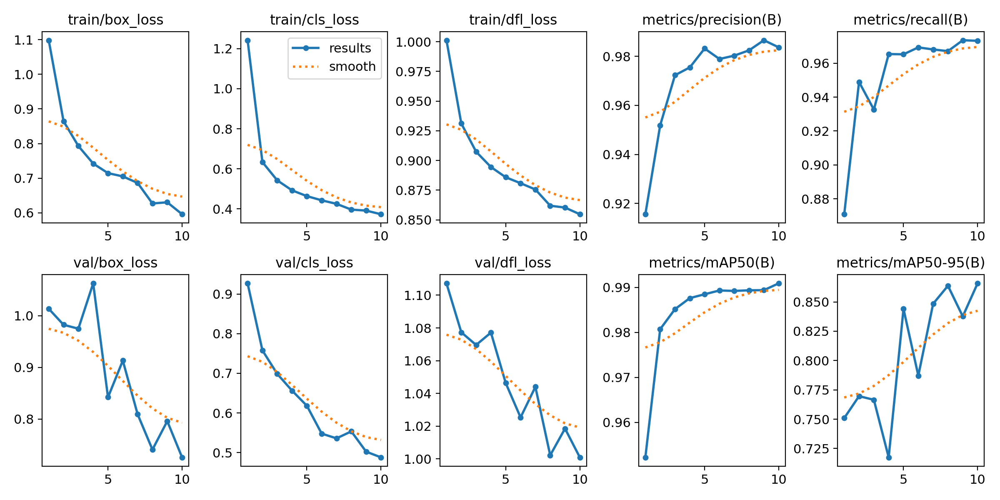

Displaying Ground Truth and Predicted images for train2:


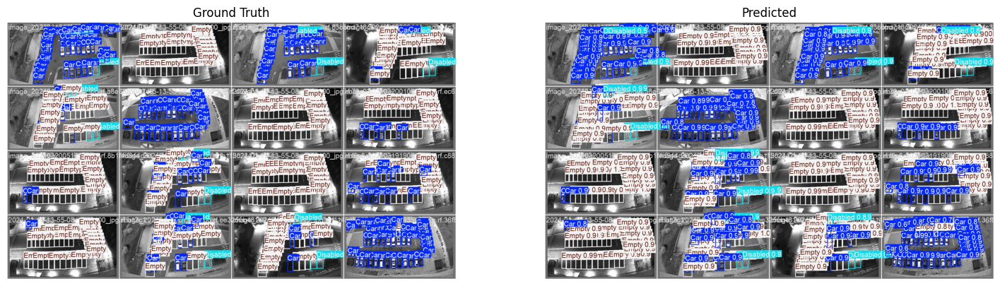

Model in train3 was trained with initial lr0=0.001 and epochs=10
Ultralytics 8.3.24 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,006,233 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /content/CarTopView-7/valid/labels.cache... 109 images, 0 backgrounds, 0 corrupt: 100%|██████████| 109/109 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.10s/it]


                   all        109       4023      0.984      0.973      0.991      0.866
                   Car        103       1680      0.976      0.962      0.987      0.831
              Disabled         71        277      0.985      0.975      0.992      0.852
                 Empty         98       2066       0.99      0.983      0.994      0.915
Speed: 1.3ms preprocess, 3.2ms inference, 0.0ms loss, 42.7ms postprocess per image
Results saved to runs/detect/val26
Evaluation results for model in train3:
mAP@0.5: 0.9909
mAP@0.5:0.95: 0.8660
Displaying results.png for train3:


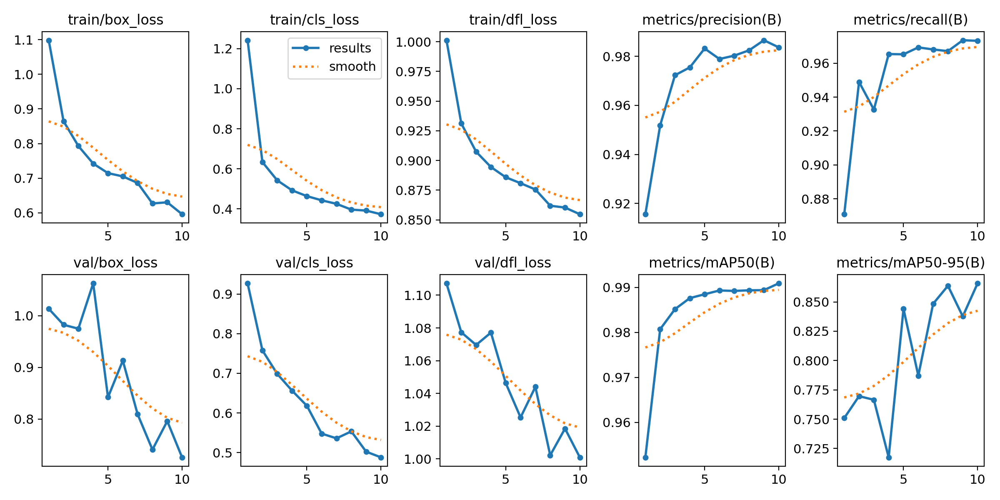

Displaying Ground Truth and Predicted images for train3:


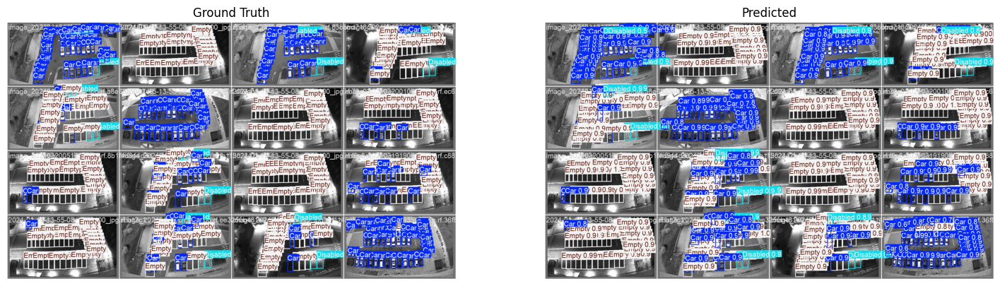

Model in train4 was trained with initial lr0=0.01 and epochs=10
Ultralytics 8.3.24 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,006,233 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /content/CarTopView-7/valid/labels.cache... 109 images, 0 backgrounds, 0 corrupt: 100%|██████████| 109/109 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.06s/it]


                   all        109       4023      0.983      0.978      0.991      0.868
                   Car        103       1680      0.972      0.966      0.985      0.825
              Disabled         71        277      0.996      0.982      0.993      0.867
                 Empty         98       2066       0.98      0.986      0.994      0.913
Speed: 1.1ms preprocess, 5.6ms inference, 0.0ms loss, 38.4ms postprocess per image
Results saved to runs/detect/val27
Evaluation results for model in train4:
mAP@0.5: 0.9909
mAP@0.5:0.95: 0.8681
Displaying results.png for train4:


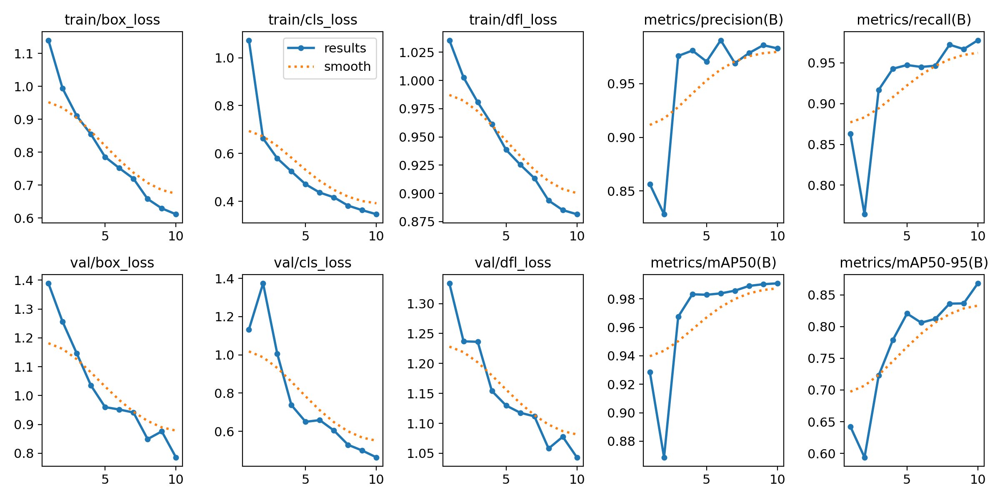

Displaying Ground Truth and Predicted images for train4:


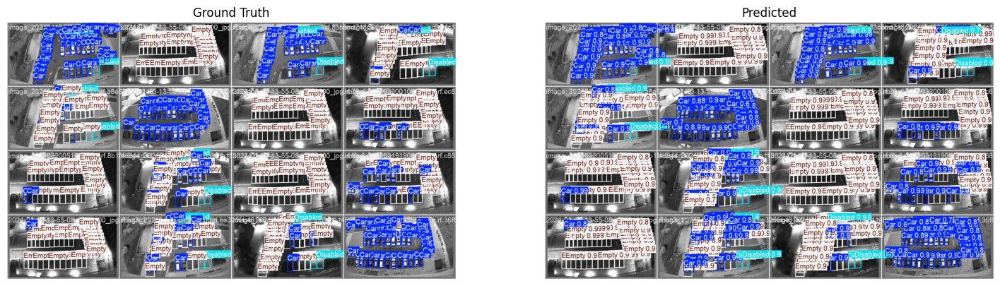

Model in train5 was trained with initial lr0=0.01 and epochs=10
Ultralytics 8.3.24 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,006,233 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /content/CarTopView-7/valid/labels.cache... 109 images, 0 backgrounds, 0 corrupt: 100%|██████████| 109/109 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.03s/it]


                   all        109       4023      0.983      0.978      0.991      0.868
                   Car        103       1680      0.972      0.966      0.985      0.825
              Disabled         71        277      0.996      0.982      0.993      0.867
                 Empty         98       2066       0.98      0.986      0.994      0.913
Speed: 1.2ms preprocess, 6.2ms inference, 0.0ms loss, 25.5ms postprocess per image
Results saved to runs/detect/val28
Evaluation results for model in train5:
mAP@0.5: 0.9909
mAP@0.5:0.95: 0.8681
Displaying results.png for train5:


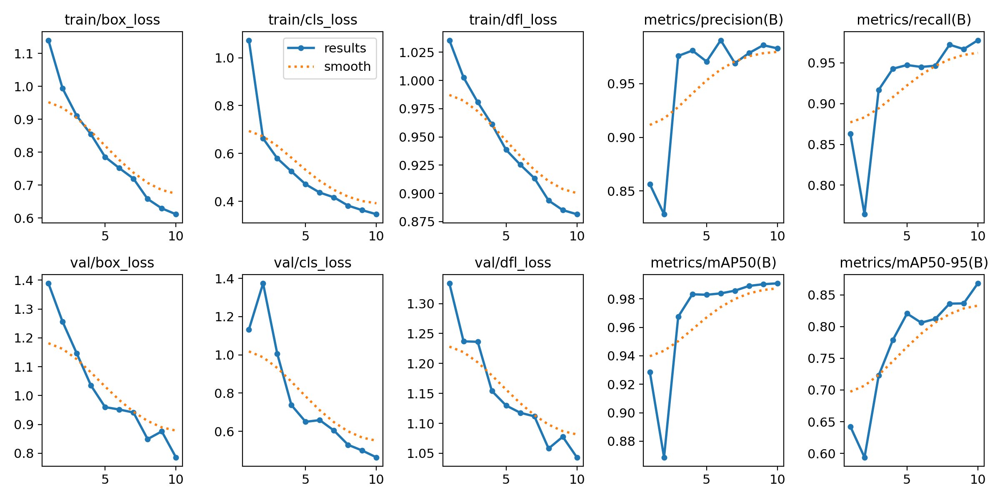

Displaying Ground Truth and Predicted images for train5:


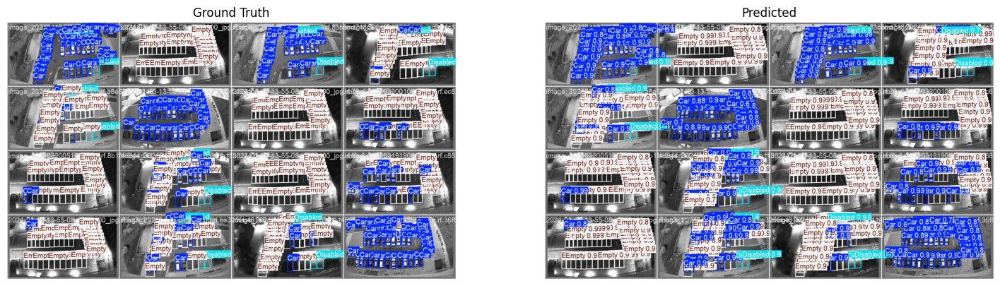

Model in train6 was trained with initial lr0=0.01 and epochs=10
Ultralytics 8.3.24 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,006,233 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /content/CarTopView-7/valid/labels.cache... 109 images, 0 backgrounds, 0 corrupt: 100%|██████████| 109/109 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.06s/it]


                   all        109       4023      0.983      0.978      0.991      0.868
                   Car        103       1680      0.972      0.966      0.985      0.825
              Disabled         71        277      0.996      0.982      0.993      0.867
                 Empty         98       2066       0.98      0.986      0.994      0.913
Speed: 1.4ms preprocess, 11.3ms inference, 0.3ms loss, 35.9ms postprocess per image
Results saved to runs/detect/val29
Evaluation results for model in train6:
mAP@0.5: 0.9909
mAP@0.5:0.95: 0.8681
Displaying results.png for train6:


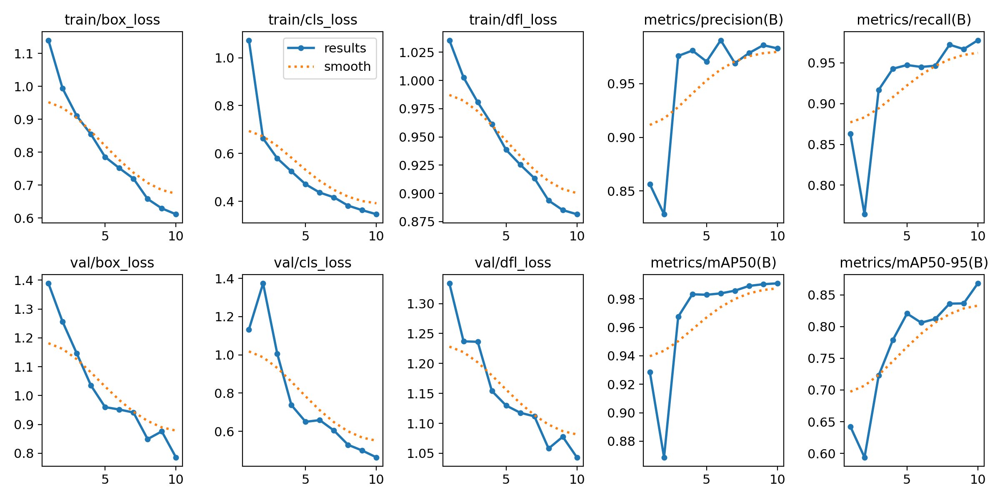

Displaying Ground Truth and Predicted images for train6:


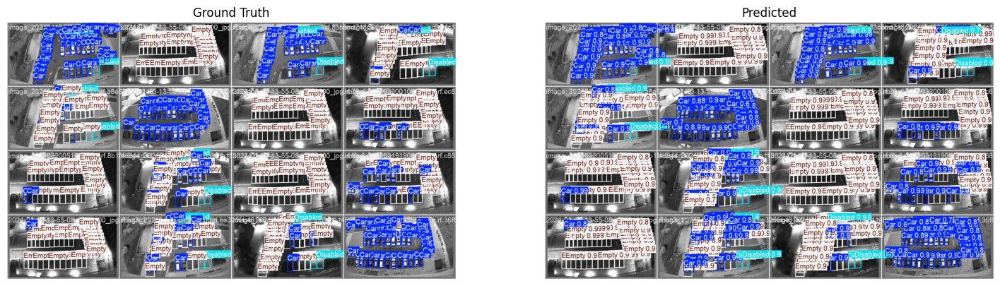

Model in train7 was trained with initial lr0=0.1 and epochs=10
Ultralytics 8.3.24 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,006,233 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /content/CarTopView-7/valid/labels.cache... 109 images, 0 backgrounds, 0 corrupt: 100%|██████████| 109/109 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.11s/it]


                   all        109       4023       0.98      0.967      0.986      0.836
                   Car        103       1680      0.985      0.942       0.98      0.791
              Disabled         71        277      0.982      0.975      0.986      0.836
                 Empty         98       2066      0.973      0.984      0.994      0.881
Speed: 1.3ms preprocess, 8.6ms inference, 0.0ms loss, 22.2ms postprocess per image
Results saved to runs/detect/val30
Evaluation results for model in train7:
mAP@0.5: 0.9864
mAP@0.5:0.95: 0.8363
Displaying results.png for train7:


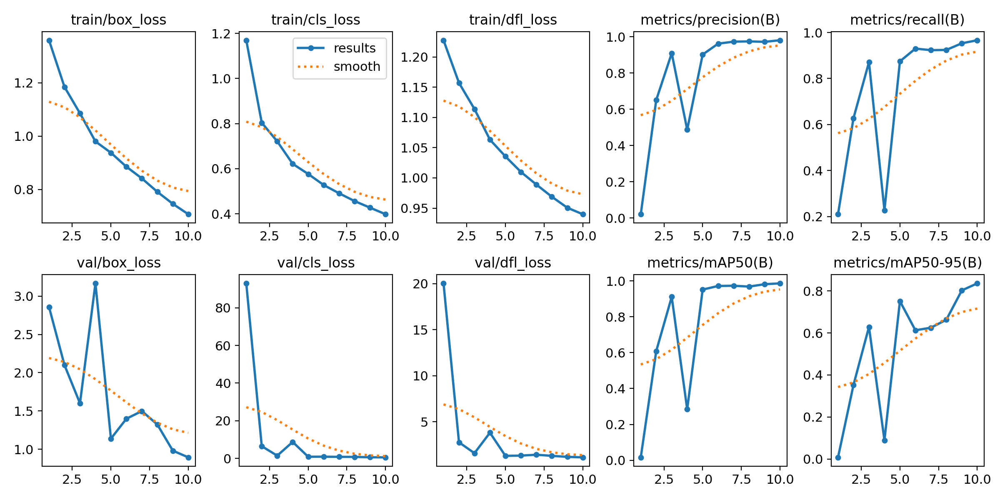

Displaying Ground Truth and Predicted images for train7:


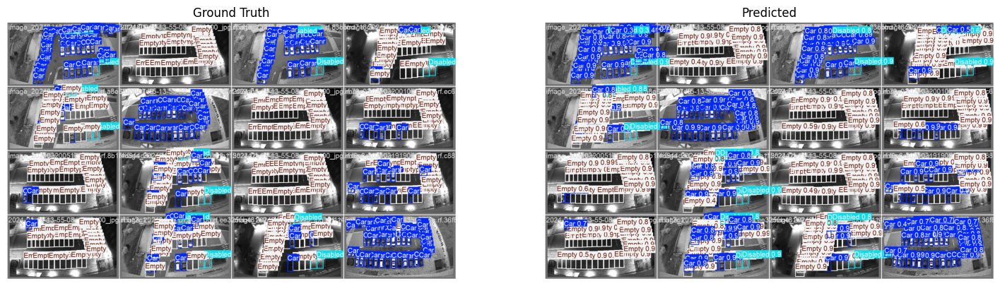

Model in train8 was trained with initial lr0=0.1 and epochs=10
Ultralytics 8.3.24 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,006,233 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /content/CarTopView-7/valid/labels.cache... 109 images, 0 backgrounds, 0 corrupt: 100%|██████████| 109/109 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.04s/it]


                   all        109       4023       0.98      0.967      0.986      0.836
                   Car        103       1680      0.985      0.942       0.98      0.791
              Disabled         71        277      0.982      0.975      0.986      0.836
                 Empty         98       2066      0.973      0.984      0.994      0.881
Speed: 1.3ms preprocess, 15.1ms inference, 0.0ms loss, 17.5ms postprocess per image
Results saved to runs/detect/val31
Evaluation results for model in train8:
mAP@0.5: 0.9864
mAP@0.5:0.95: 0.8363
Displaying results.png for train8:


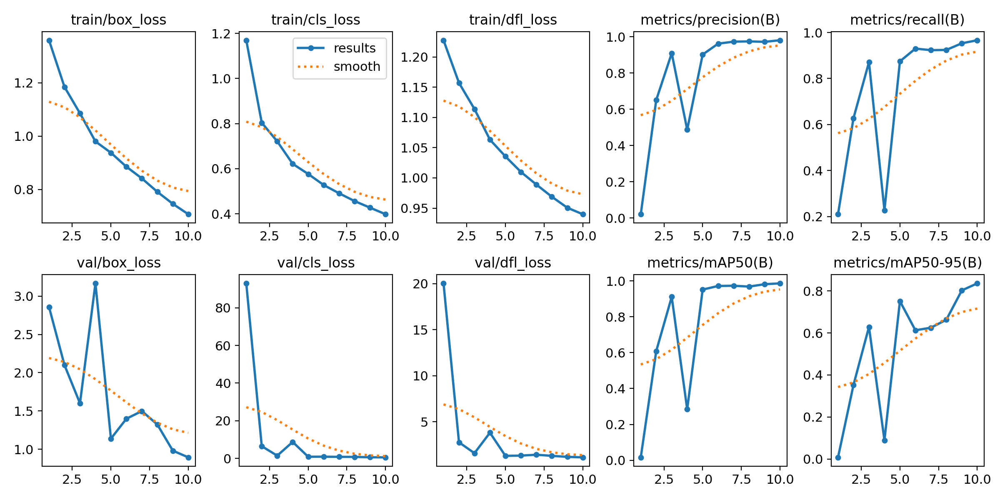

Displaying Ground Truth and Predicted images for train8:


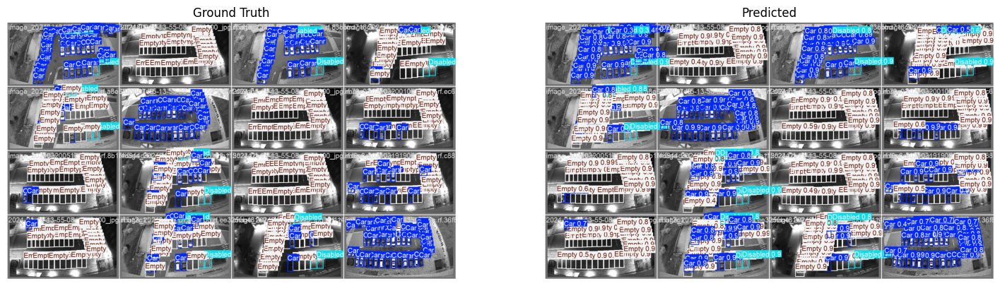

Model in train9 was trained with initial lr0=0.1 and epochs=10
Ultralytics 8.3.24 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,006,233 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /content/CarTopView-7/valid/labels.cache... 109 images, 0 backgrounds, 0 corrupt: 100%|██████████| 109/109 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.05s/it]


                   all        109       4023       0.98      0.967      0.986      0.836
                   Car        103       1680      0.985      0.942       0.98      0.791
              Disabled         71        277      0.982      0.975      0.986      0.836
                 Empty         98       2066      0.973      0.984      0.994      0.881
Speed: 1.2ms preprocess, 4.6ms inference, 0.0ms loss, 28.1ms postprocess per image
Results saved to runs/detect/val32
Evaluation results for model in train9:
mAP@0.5: 0.9864
mAP@0.5:0.95: 0.8363
Displaying results.png for train9:


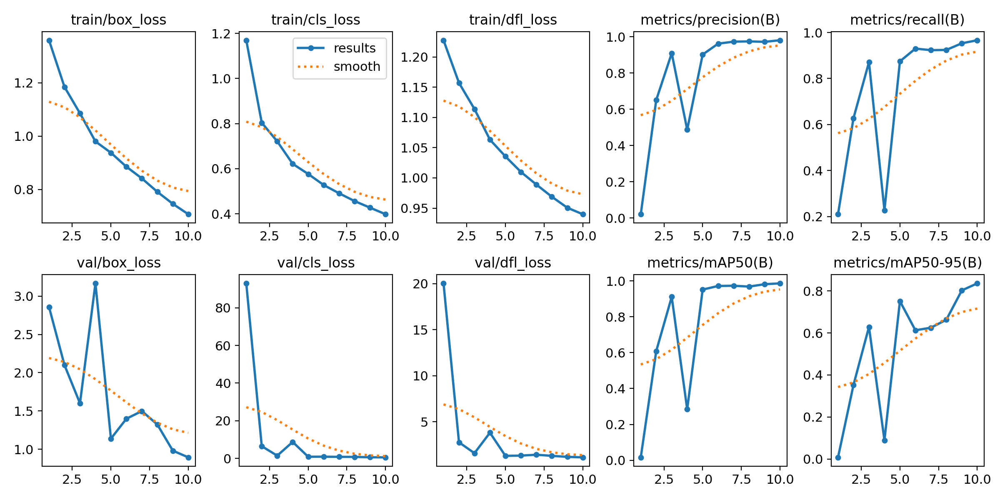

Displaying Ground Truth and Predicted images for train9:


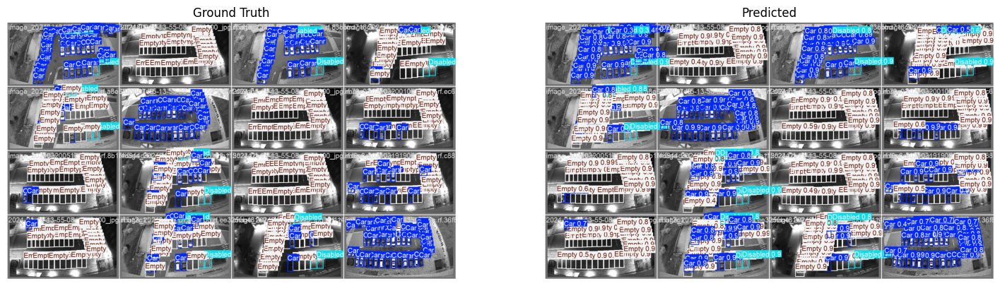

Model in train10 was trained with initial lr0=0.001 and epochs=50
Ultralytics 8.3.24 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,006,233 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /content/CarTopView-7/valid/labels.cache... 109 images, 0 backgrounds, 0 corrupt: 100%|██████████| 109/109 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.11s/it]


                   all        109       4023      0.992      0.977       0.99      0.884
                   Car        103       1680      0.986      0.972      0.987      0.843
              Disabled         71        277      0.996      0.982       0.99      0.885
                 Empty         98       2066      0.996      0.978      0.994      0.925
Speed: 1.4ms preprocess, 3.6ms inference, 0.0ms loss, 37.8ms postprocess per image
Results saved to runs/detect/val33
Evaluation results for model in train10:
mAP@0.5: 0.9904
mAP@0.5:0.95: 0.8844
Displaying results.png for train10:


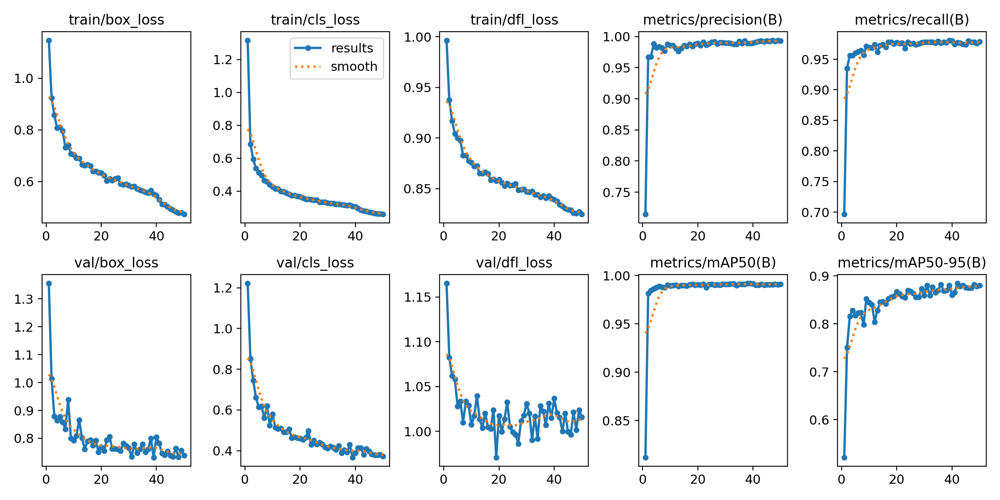

Displaying Ground Truth and Predicted images for train10:


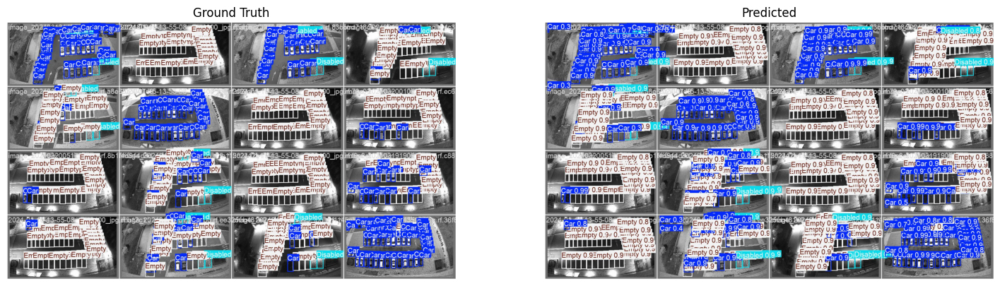

In [19]:
from ultralytics import YOLO
import os
import yaml
from IPython.display import display
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Base directory containing the train folders
base_dir = '/content/drive/MyDrive/parkingGridsearch'

# Loop through folders from train2 to train10
for i in range(2, 11):
    folder_path = os.path.join(base_dir, f'train{i}')

    # Load hyperparameters from args.yaml
    args_path = os.path.join(folder_path, 'args.yaml')
    if os.path.exists(args_path):
        with open(args_path, 'r') as file:
            args = yaml.safe_load(file)
        lr0 = args.get('lr0', 'N/A')
        epochs = args.get('epochs', 'N/A')
        print(f"Model in train{i} was trained with initial lr0={lr0} and epochs={epochs}")
    else:
        print(f"args.yaml not found in train{i}")
        continue

    # Load and evaluate the model
    model_path = os.path.join(folder_path, 'weights/best.pt')
    model = YOLO(model_path)
    results = model.val()

    # Extract and print specific evaluation metrics
    map_50 = results.box.map50  # mAP at IoU threshold 0.5
    map_95 = results.box.map    # mAP at IoU threshold 0.5:0.95

    print(f"Evaluation results for model in train{i}:")
    print(f"mAP@0.5: {map_50:.4f}")
    print(f"mAP@0.5:0.95: {map_95:.4f}")
    print("=" * 50)

    # Display results.png
    results_png = os.path.join(folder_path, 'results.png')
    if os.path.exists(results_png):
        print(f"Displaying results.png for train{i}:")
        display(Image(filename=results_png))
    else:
        print(f"results.png not found in train{i}")

    # Display val_batch2_labels.jpg as "Ground Truth" and val_batch2_pred.jpg as "Predicted" side by side
    labels_image_path = os.path.join(folder_path, 'val_batch2_labels.jpg')
    pred_image_path = os.path.join(folder_path, 'val_batch2_pred.jpg')

    if os.path.exists(labels_image_path) and os.path.exists(pred_image_path):
        print(f"Displaying Ground Truth and Predicted images for train{i}:")

        # Set up the side-by-side plot
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 9))

        # Load and display each image
        img_labels = mpimg.imread(labels_image_path)
        img_pred = mpimg.imread(pred_image_path)

        ax1.imshow(img_labels)
        ax1.set_title('Ground Truth')
        ax1.axis('off')

        ax2.imshow(img_pred)
        ax2.set_title('Predicted')
        ax2.axis('off')

        plt.show()
    else:
        print(f"val_batch2_labels.jpg or val_batch2_pred.jpg not found in train{i}")

    print("=" * 100)  # Separator line for readability


Model in train2 was trained with initial lr0=0.001 and epochs=10
Ultralytics 8.3.24 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,006,233 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /content/CarTopView-7/valid/labels.cache... 109 images, 0 backgrounds, 0 corrupt: 100%|██████████| 109/109 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.06s/it]


                   all        109       4023      0.991      0.967      0.982      0.879
                   Car        103       1680      0.985      0.949      0.973      0.848
              Disabled         71        277      0.993      0.975      0.987      0.863
                 Empty         98       2066      0.995      0.977      0.987      0.926
Speed: 1.4ms preprocess, 14.3ms inference, 0.0ms loss, 18.6ms postprocess per image
Results saved to runs/detect/val34
Evaluation results for model in train2:
mAP@0.5: 0.9825
mAP@0.5:0.95: 0.8789
Displaying results.png for train2:


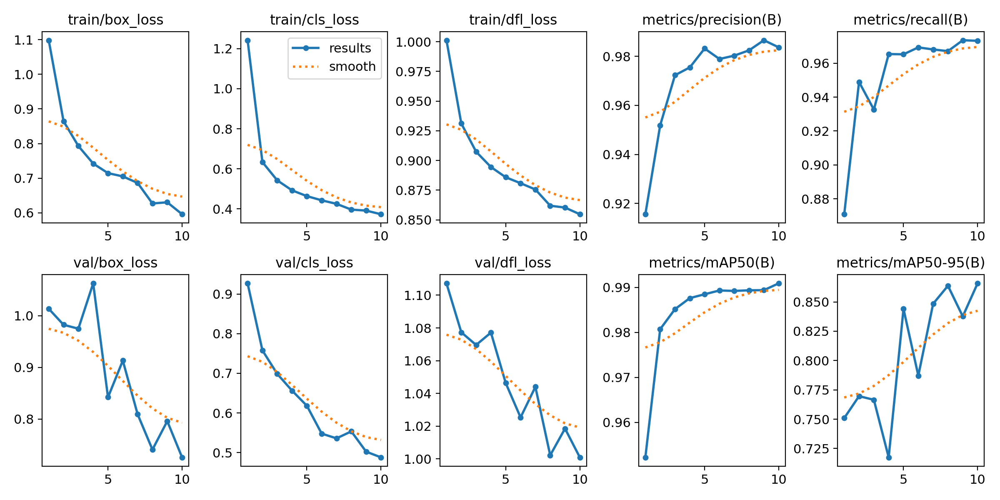

Displaying Ground Truth and Predicted images for train2:


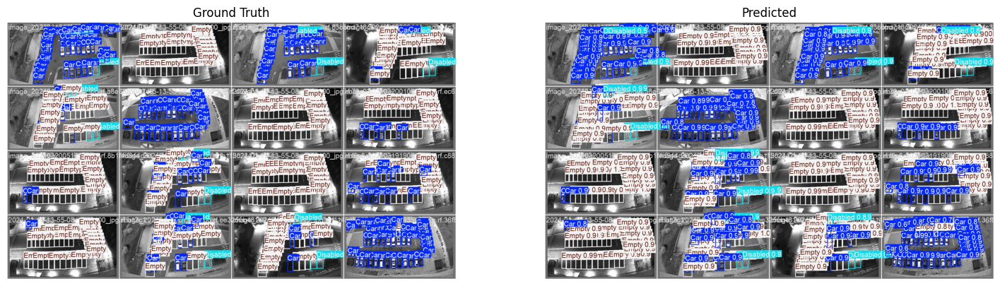

Model in train3 was trained with initial lr0=0.001 and epochs=10
Ultralytics 8.3.24 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,006,233 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /content/CarTopView-7/valid/labels.cache... 109 images, 0 backgrounds, 0 corrupt: 100%|██████████| 109/109 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.07s/it]


                   all        109       4023      0.991      0.967      0.982      0.879
                   Car        103       1680      0.985      0.949      0.973      0.848
              Disabled         71        277      0.993      0.975      0.987      0.863
                 Empty         98       2066      0.995      0.977      0.987      0.926
Speed: 1.4ms preprocess, 3.2ms inference, 0.0ms loss, 40.8ms postprocess per image
Results saved to runs/detect/val35
Evaluation results for model in train3:
mAP@0.5: 0.9825
mAP@0.5:0.95: 0.8789
Displaying results.png for train3:


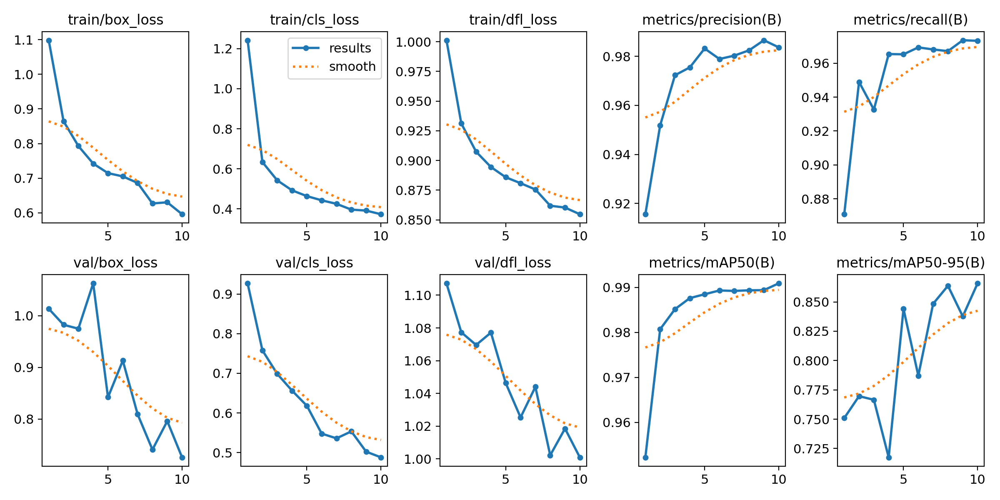

Displaying Ground Truth and Predicted images for train3:


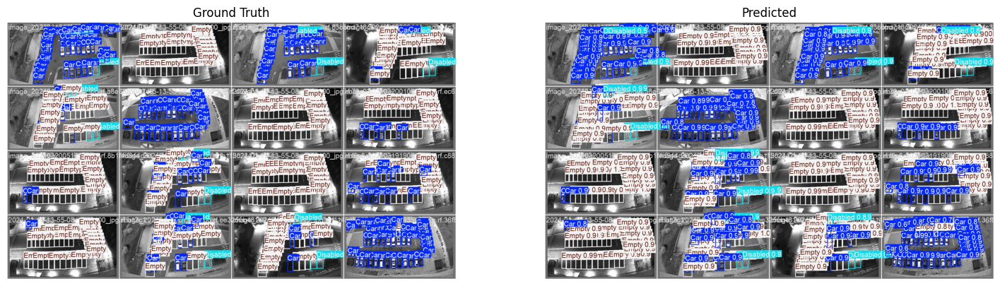

Model in train4 was trained with initial lr0=0.01 and epochs=10
Ultralytics 8.3.24 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,006,233 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /content/CarTopView-7/valid/labels.cache... 109 images, 0 backgrounds, 0 corrupt: 100%|██████████| 109/109 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.04s/it]


                   all        109       4023      0.992      0.961       0.98      0.879
                   Car        103       1680       0.99      0.942       0.97      0.837
              Disabled         71        277      0.996      0.971      0.985      0.876
                 Empty         98       2066      0.991       0.97      0.985      0.922
Speed: 1.2ms preprocess, 12.8ms inference, 0.1ms loss, 35.1ms postprocess per image
Results saved to runs/detect/val36
Evaluation results for model in train4:
mAP@0.5: 0.9799
mAP@0.5:0.95: 0.8787
Displaying results.png for train4:


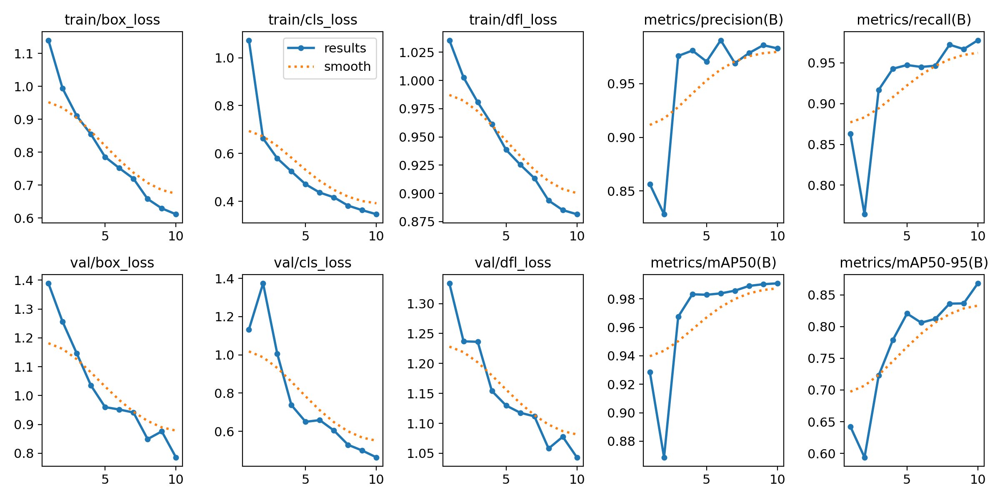

Displaying Ground Truth and Predicted images for train4:


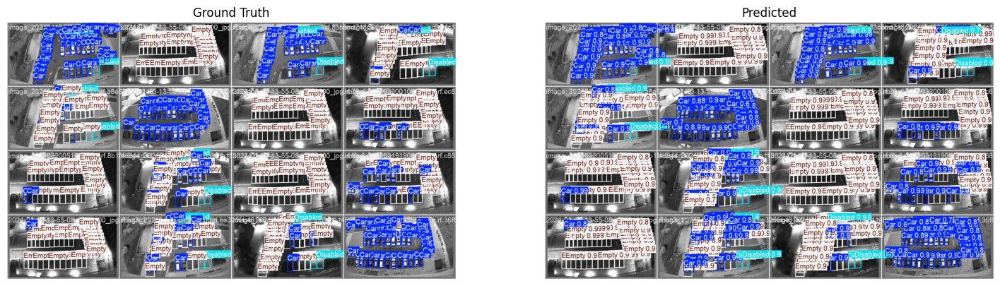

Model in train5 was trained with initial lr0=0.01 and epochs=10
Ultralytics 8.3.24 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,006,233 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /content/CarTopView-7/valid/labels.cache... 109 images, 0 backgrounds, 0 corrupt: 100%|██████████| 109/109 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.12s/it]


                   all        109       4023      0.992      0.961       0.98      0.879
                   Car        103       1680       0.99      0.942       0.97      0.837
              Disabled         71        277      0.996      0.971      0.985      0.876
                 Empty         98       2066      0.991       0.97      0.985      0.922
Speed: 1.3ms preprocess, 4.4ms inference, 0.0ms loss, 40.2ms postprocess per image
Results saved to runs/detect/val37
Evaluation results for model in train5:
mAP@0.5: 0.9799
mAP@0.5:0.95: 0.8787
Displaying results.png for train5:


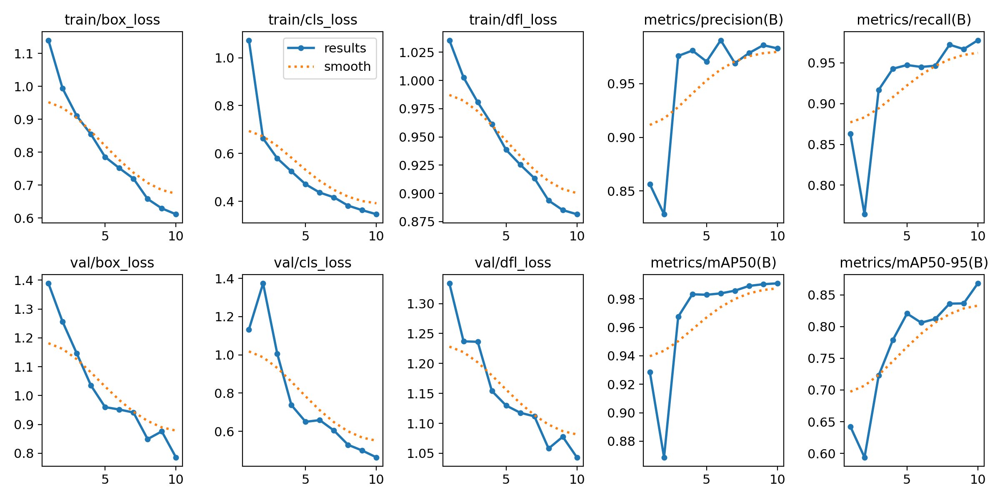

Displaying Ground Truth and Predicted images for train5:


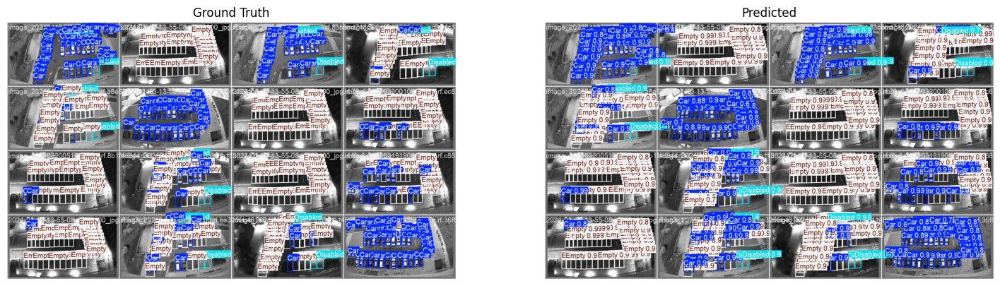

Model in train6 was trained with initial lr0=0.01 and epochs=10
Ultralytics 8.3.24 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,006,233 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /content/CarTopView-7/valid/labels.cache... 109 images, 0 backgrounds, 0 corrupt: 100%|██████████| 109/109 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.05s/it]


                   all        109       4023      0.992      0.961       0.98      0.879
                   Car        103       1680       0.99      0.942       0.97      0.837
              Disabled         71        277      0.996      0.971      0.985      0.876
                 Empty         98       2066      0.991       0.97      0.985      0.922
Speed: 1.2ms preprocess, 5.1ms inference, 0.0ms loss, 42.3ms postprocess per image
Results saved to runs/detect/val38
Evaluation results for model in train6:
mAP@0.5: 0.9799
mAP@0.5:0.95: 0.8787
Displaying results.png for train6:


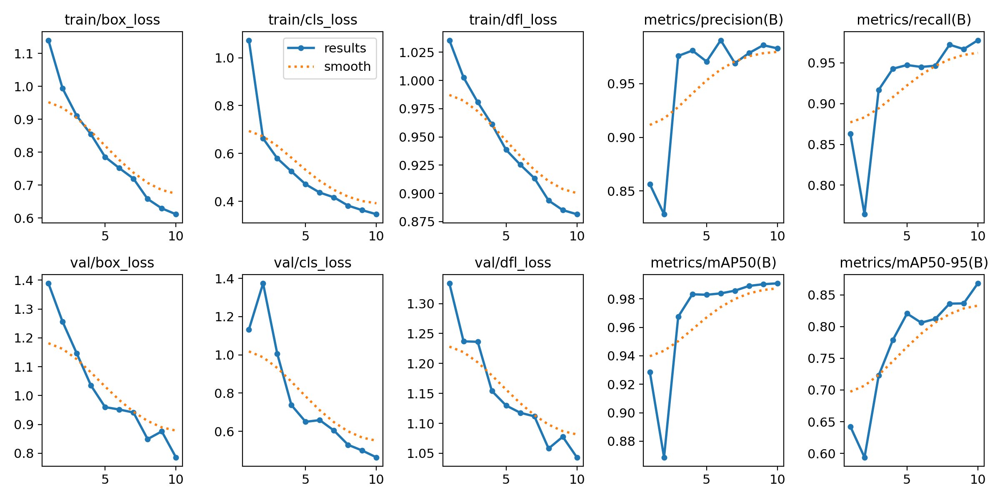

Displaying Ground Truth and Predicted images for train6:


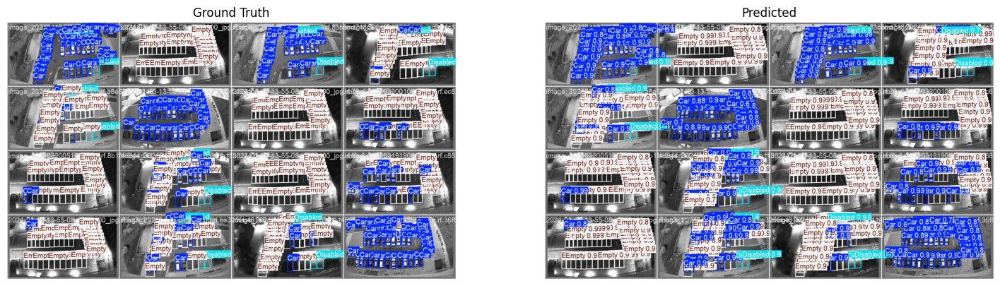

Model in train7 was trained with initial lr0=0.1 and epochs=10
Ultralytics 8.3.24 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,006,233 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /content/CarTopView-7/valid/labels.cache... 109 images, 0 backgrounds, 0 corrupt: 100%|██████████| 109/109 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.04s/it]


                   all        109       4023      0.993      0.949      0.974      0.853
                   Car        103       1680      0.993      0.902       0.95      0.809
              Disabled         71        277      0.996      0.975      0.987      0.858
                 Empty         98       2066       0.99       0.97      0.985      0.893
Speed: 1.5ms preprocess, 11.4ms inference, 0.0ms loss, 21.8ms postprocess per image
Results saved to runs/detect/val39
Evaluation results for model in train7:
mAP@0.5: 0.9739
mAP@0.5:0.95: 0.8530
Displaying results.png for train7:


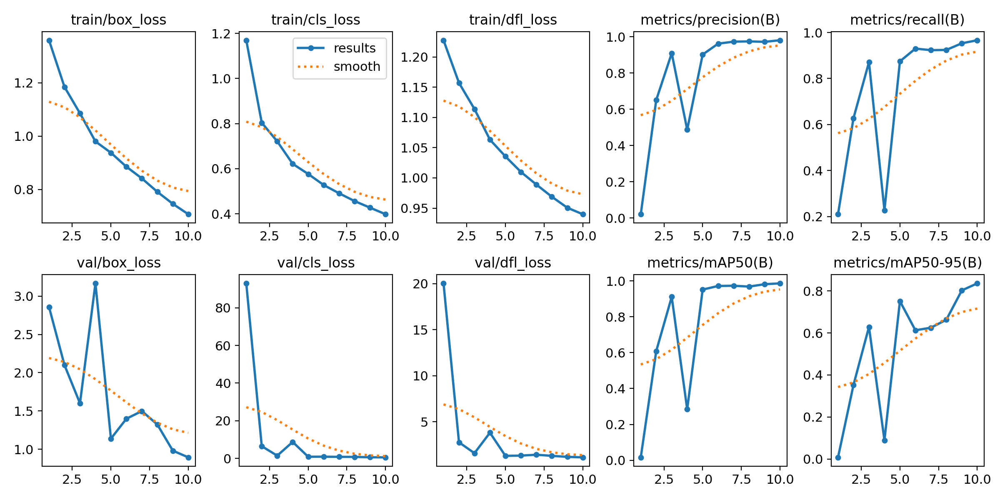

Displaying Ground Truth and Predicted images for train7:


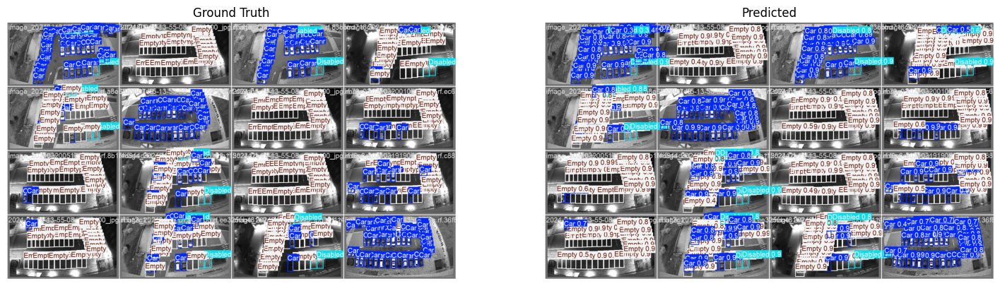

Model in train8 was trained with initial lr0=0.1 and epochs=10
Ultralytics 8.3.24 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,006,233 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /content/CarTopView-7/valid/labels.cache... 109 images, 0 backgrounds, 0 corrupt: 100%|██████████| 109/109 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.06s/it]


                   all        109       4023      0.993      0.949      0.974      0.853
                   Car        103       1680      0.993      0.902       0.95      0.809
              Disabled         71        277      0.996      0.975      0.987      0.858
                 Empty         98       2066       0.99       0.97      0.985      0.893
Speed: 1.3ms preprocess, 15.6ms inference, 0.0ms loss, 27.9ms postprocess per image
Results saved to runs/detect/val40
Evaluation results for model in train8:
mAP@0.5: 0.9739
mAP@0.5:0.95: 0.8530
Displaying results.png for train8:


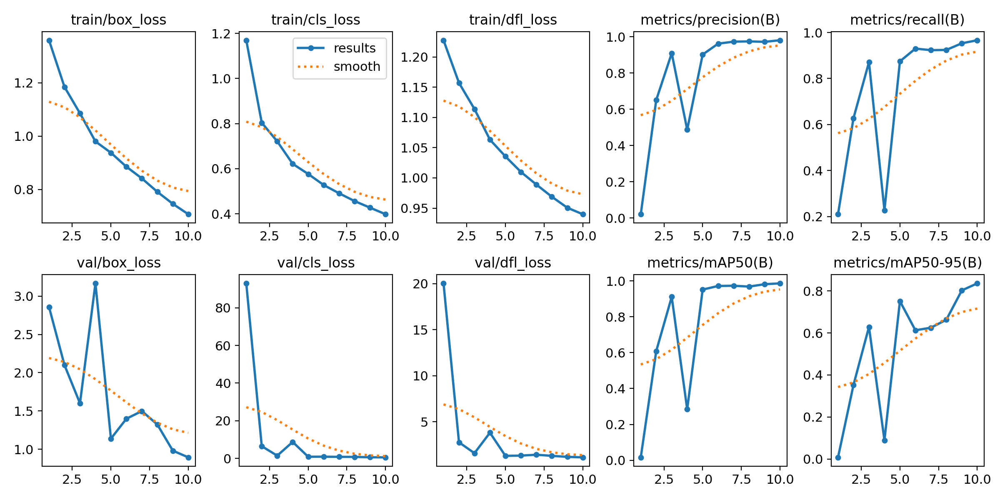

Displaying Ground Truth and Predicted images for train8:


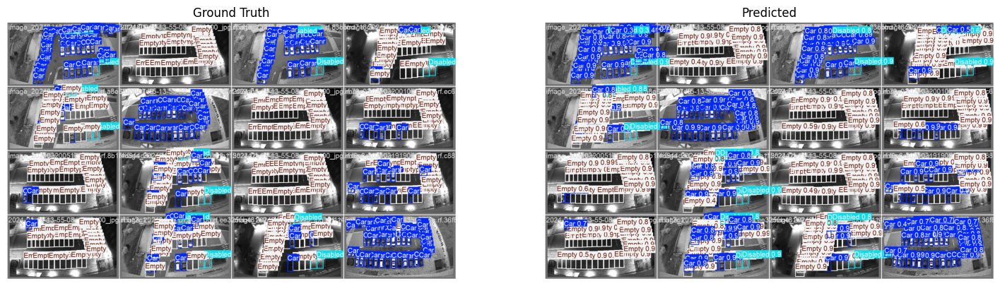

Model in train9 was trained with initial lr0=0.1 and epochs=10
Ultralytics 8.3.24 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,006,233 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /content/CarTopView-7/valid/labels.cache... 109 images, 0 backgrounds, 0 corrupt: 100%|██████████| 109/109 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.05s/it]


                   all        109       4023      0.993      0.949      0.974      0.853
                   Car        103       1680      0.993      0.902       0.95      0.809
              Disabled         71        277      0.996      0.975      0.987      0.858
                 Empty         98       2066       0.99       0.97      0.985      0.893
Speed: 1.3ms preprocess, 3.5ms inference, 0.0ms loss, 28.4ms postprocess per image
Results saved to runs/detect/val41
Evaluation results for model in train9:
mAP@0.5: 0.9739
mAP@0.5:0.95: 0.8530
Displaying results.png for train9:


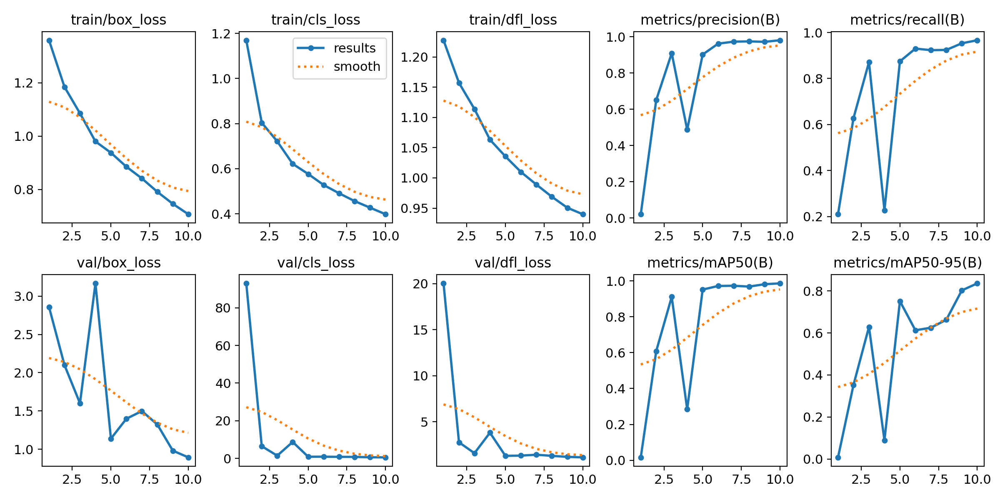

Displaying Ground Truth and Predicted images for train9:


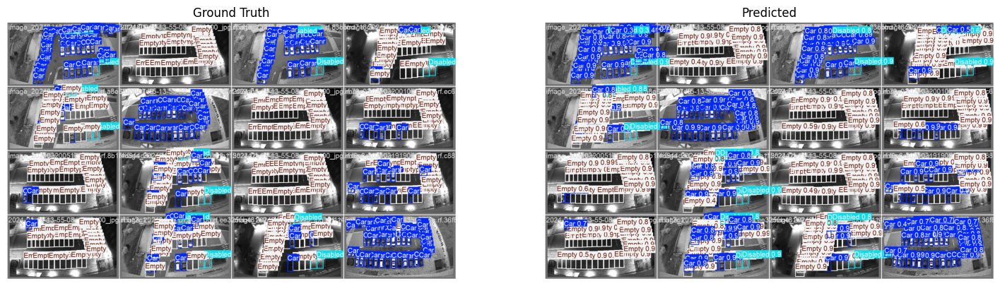

Model in train10 was trained with initial lr0=0.001 and epochs=50
Ultralytics 8.3.24 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,006,233 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /content/CarTopView-7/valid/labels.cache... 109 images, 0 backgrounds, 0 corrupt: 100%|██████████| 109/109 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:07<00:00,  1.05s/it]


                   all        109       4023      0.993      0.977      0.988      0.897
                   Car        103       1680      0.986      0.972      0.985      0.864
              Disabled         71        277      0.996      0.982       0.99      0.895
                 Empty         98       2066      0.996      0.978      0.988      0.932
Speed: 1.3ms preprocess, 5.8ms inference, 0.0ms loss, 32.5ms postprocess per image
Results saved to runs/detect/val42
Evaluation results for model in train10:
mAP@0.5: 0.9879
mAP@0.5:0.95: 0.8969
Displaying results.png for train10:


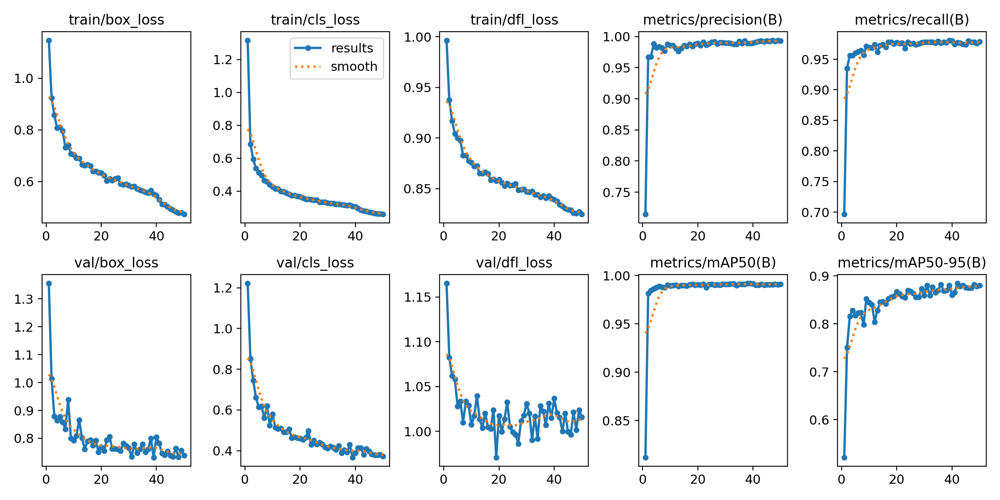

Displaying Ground Truth and Predicted images for train10:


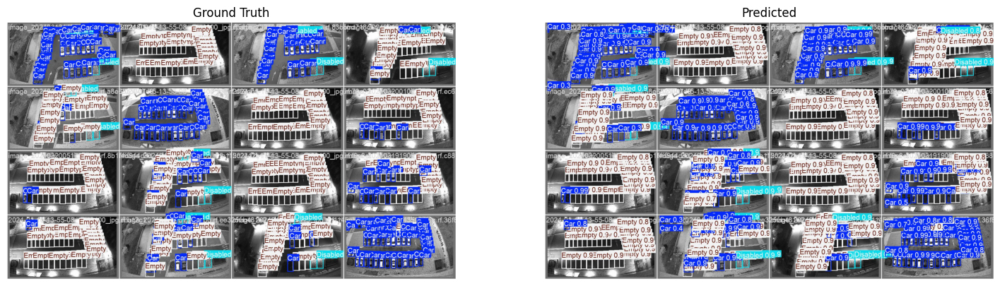

In [23]:
from ultralytics import YOLO
import os
import yaml
from IPython.display import display
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Base directory containing the train folders
base_dir = '/content/drive/MyDrive/parkingGridsearch'

# Loop through folders from train2 to train10
for i in range(2, 11):
    folder_path = os.path.join(base_dir, f'train{i}')

    # Load hyperparameters from args.yaml
    args_path = os.path.join(folder_path, 'args.yaml')
    if os.path.exists(args_path):
        with open(args_path, 'r') as file:
            args = yaml.safe_load(file)
        lr0 = args.get('lr0', 'N/A')
        epochs = args.get('epochs', 'N/A')
        print(f"Model in train{i} was trained with initial lr0={lr0} and epochs={epochs}")
    else:
        print(f"args.yaml not found in train{i}")
        continue

    # Load and evaluate the model
    model_path = os.path.join(folder_path, 'weights/best.pt')
    model = YOLO(model_path)
    results = model.val(conf=0.5)  # Set validation threshold

    # Extract and print specific evaluation metrics
    map_50 = results.box.map50  # mAP at IoU threshold 0.5
    map_95 = results.box.map    # mAP at IoU threshold 0.5:0.95

    print(f"Evaluation results for model in train{i}:")
    print(f"mAP@0.5: {map_50:.4f}")
    print(f"mAP@0.5:0.95: {map_95:.4f}")
    print("=" * 50)

    # Display results.png
    results_png = os.path.join(folder_path, 'results.png')
    if os.path.exists(results_png):
        print(f"Displaying results.png for train{i}:")
        display(Image(filename=results_png))
    else:
        print(f"results.png not found in train{i}")

    # Display val_batch2_labels.jpg as "Ground Truth" and val_batch2_pred.jpg as "Predicted" side by side
    labels_image_path = os.path.join(folder_path, 'val_batch2_labels.jpg')
    pred_image_path = os.path.join(folder_path, 'val_batch2_pred.jpg')

    if os.path.exists(labels_image_path) and os.path.exists(pred_image_path):
        print(f"Displaying Ground Truth and Predicted images for train{i}:")

        # Set up the side-by-side plot
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 9))

        # Load and display each image
        img_labels = mpimg.imread(labels_image_path)
        img_pred = mpimg.imread(pred_image_path)

        ax1.imshow(img_labels)
        ax1.set_title('Ground Truth')
        ax1.axis('off')

        ax2.imshow(img_pred)
        ax2.set_title('Predicted')
        ax2.axis('off')

        plt.show()
    else:
        print(f"val_batch2_labels.jpg or val_batch2_pred.jpg not found in train{i}")

    print("=" * 100)  # Separator line for readability


Best results from the grid search

                  Class     Images  Instances      Box(P          R      mAP50  mAP50-95):
                   all        109       4023      0.993      0.977      0.988      0.897
                   Car        103       1680      0.986      0.972      0.985      0.864
              Disabled         71        277      0.996      0.982       0.99      0.895
                 Empty         98       2066      0.996      0.978      0.988      0.932

###Test our model on frames of our dataset

In [30]:
model = YOLO('/content/drive/MyDrive/parkingGridsearch/train10/weights/best.pt')
results = model.predict(source="/content/drive/MyDrive/ExtractedFrames/ExtractedFrames/ExtractedFrames12PM/frame_3420.jpg", save=True)



image 1/1 /content/drive/MyDrive/ExtractedFrames/ExtractedFrames/ExtractedFrames12PM/frame_3420.jpg: 384x640 35 Cars, 8 Emptys, 8.2ms
Speed: 2.3ms preprocess, 8.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Results saved to runs/detect/predict4


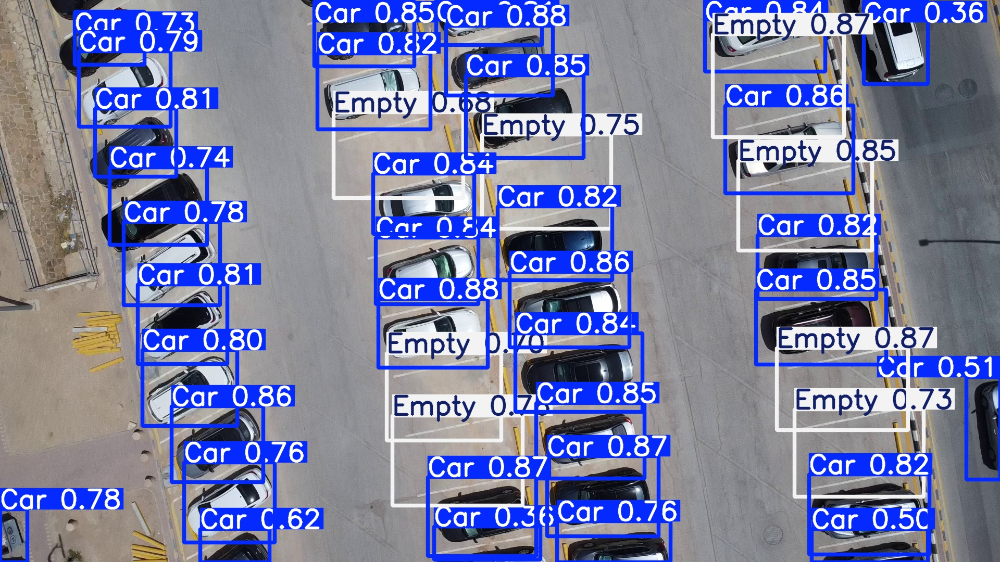

In [31]:
from IPython.display import Image as IPyImage
IPyImage(filename='/content/runs/detect/predict4/frame_3420.jpg', width=600)

In [33]:
results = model.predict(source="/content/drive/MyDrive/ExtractedFrames/ExtractedFrames/ExtractedFrames12PM/frame_120.jpg", save=True)


image 1/1 /content/drive/MyDrive/ExtractedFrames/ExtractedFrames/ExtractedFrames12PM/frame_120.jpg: 384x640 43 Cars, 4 Emptys, 7.7ms
Speed: 2.3ms preprocess, 7.7ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Results saved to runs/detect/predict4


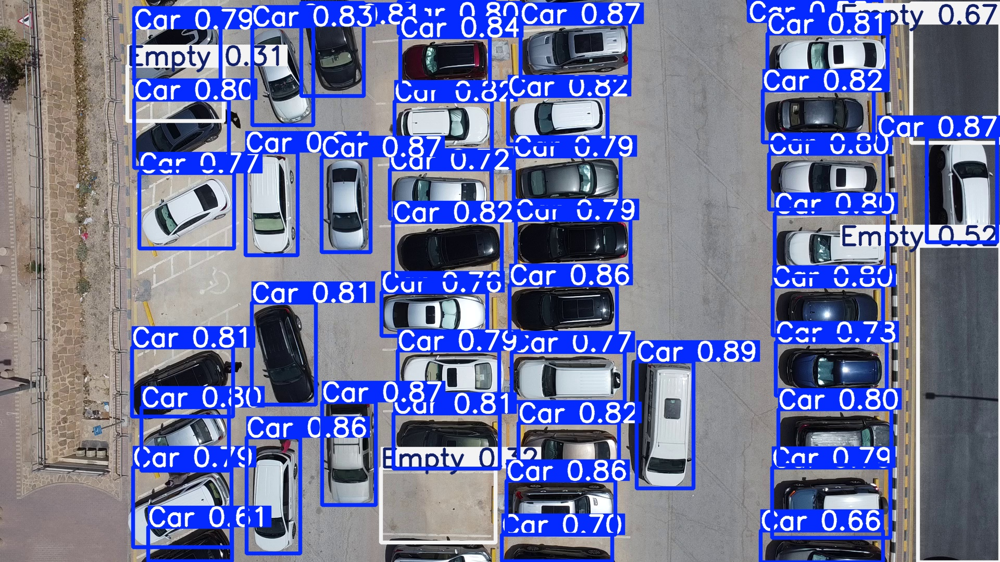

In [34]:
IPyImage(filename='/content/runs/detect/predict4/frame_120.jpg', width=600)


We notice that even with good training and validation results, the model is not detecting the "Disabled" class well in our dataset. This might be because the sign on the ground isn't clear enough for the model to see. We also see that the model is picking up moving cars, which isn’t our goal. After checking the CarTopView dataset, We found that moving cars are labeled too, which could be causing this problem.


In [ ]:
# Citations and Acknowledgments

# @software{yolo11_ultralytics,
#   author = {Glenn Jocher and Jing Qiu},
#   title = {Ultralytics YOLO11},
#   version = {11.0.0},
#   year = {2024},
#   url = {https://github.com/ultralytics/ultralytics},
#   orcid = {0000-0001-5950-6979, 0000-0002-7603-6750, 0000-0003-3783-7069},
#   license = {AGPL-3.0}
# }